In [207]:
import importlib
import time
import numpy as np
import scipy as sp
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
from scipy import ndimage
from scipy import integrate
from scipy import interpolate

In [2]:
from multi_loc import covariance, assimilate, utilities

/home/travisharty/anaconda3/envs/loc/lib/python3.7/site-packages/sklearn/utils/__init__.py:4: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated, and in 3.8 it will stop working
  from collections import Sequence


In [3]:
%matplotlib inline

In [4]:
def imshow(X, title=None, vmin=None, vmax=None, cmap=None):
    plt.figure()
    im = plt.imshow(X, vmin=vmin, vmax=vmax, cmap=cmap)
    plt.colorbar(im)
    plt.title(title)

In [450]:
N_Z = 960
K = 32
I = 12
F = float(15)
b = float(10)
c = float(2.5)
alpha = (3 * I**2 + 3) / (2 * I**3 + 4 * I)
beta = (2 * I**2 + 1) / (I**4 + 2 * I**2)

coarse = 8
N_Xc = N_Z//coarse
K_c = K//coarse

N_eZ = 20
N_eX = 100

# Long run to generate ensemble

In [337]:
# X_interp = np.random.uniform(low=-5, high=10, size=N_Z//K)
# X_interp = np.concatenate([X_interp, [X_interp[0]]])
# x = np.arange(N_Z)
# x_interp = x[::K]
# x_interp = np.concatenate([x_interp, [x[-1] + 1]])
# f_X = interpolate.interp1d(x_interp, X_interp, kind='quadratic')
# X0 = f_X(x)
# Y0 = np.random.uniform(low=-0.5, high=1, size=N_Z)
# Z0 = X0 + X0*Y0/X0.max()
# t = np.linspace(0, 20, 100)
# Z = utilities.return_LM3_data(Z0, t, K=K, I=I, F=F, b=b, c=c)
# Z0 = Z[:, -1]
T = 1000
dt = 0.05
N_t = int(T/dt + 1)
t = np.linspace(0, T, N_t)
# Z = utilities.return_LM3_data(Z0, t, K=K, I=I, F=F, b=b, c=c)
# np.save('./Z_long_run.npy', Z)

Z = np.load('./Z_long_run.npy')

# Generate ensemble from long run

In [338]:
# X0_ens, Z0_ens = utilities.generate_X_Z_LM3_ens(
#     Z, N_eX, N_eZ, coarse, I, alpha, beta)

# np.save('Z0_ens', Z0_ens)
# np.save('X0_ens', X0_ens)

# # Z0_ens = np.load('Z0_ens.npy')
# # X0_ens = np.load('X0_ens.npy')

In [339]:
P_X = np.cov(X0_ens)
P_Z = np.cov(Z0_ens)

In [340]:
H_sub = np.eye(P_X.shape[0])
R_sub = 1 * np.eye(P_X.shape[0])

In [627]:
# X_interp = np.random.uniform(low=-5, high=10, size=N_Z//K)
# X_interp = np.concatenate([X_interp, [X_interp[0]]])
# x = np.arange(N_Z)
# x_interp = x[::K]
# x_interp = np.concatenate([x_interp, [x[-1] + 1]])
# f_X = interpolate.interp1d(x_interp, X_interp, kind='quadratic')
# X0 = f_X(x)
# Y0 = np.random.uniform(low=-0.5, high=1, size=N_Z)
# Z0 = X0 + X0*Y0/X0.max()
# T = 20
# dt = 0.05
# N_t = int(T/dt + 1)
# t = np.round(np.linspace(0, T, N_t), 2)
# Z_temp = utilities.return_LM3_data(Z0, t, K=K, I=I, F=F, b=b, c=c)
# Z0 = Z_temp[:, -1]
T = 11
dt = 0.01
N_t = int(T/dt + 1)
t = np.round(np.linspace(0, T, N_t), 2)
# Z_GT = utilities.return_LM3_data(Z0, t, K=K, I=I, F=F, b=b, c=c)
# np.save('./Z_GT.npy', Z_GT)

Z_GT = np.load('./Z_GT.npy')

In [628]:
# X_GT = utilities.window_sum_Z(Z_GT, I=I, alpha=alpha, beta=beta)
# Y_GT = Z_GT - X_GT
# np.save('./X_GT.npy', X_GT)
# np.save('./Y_GT.npy', Y_GT)

X_GT = np.load('./X_GT.npy')
Y_GT = np.load('./Y_GT.npy')

In [629]:
print(f'Var of Z: {np.var(Z_GT)}')
print(f'Abs mean of Z: {np.mean(np.abs(Z_GT))}')
print(f'Var of Y: {np.var(Y_GT)}')
print(f'Abs mean of Y: {np.mean(np.abs(Y_GT))}')
print(f'Var of X: {np.var(X_GT)}')
print(f'Abs mean of X: {np.mean(np.abs(X_GT))}')

Var of Z: 22.136816965775267
Abs mean of Z: 4.5265800834757846
Var of Y: 0.02568289832474313
Abs mean of Y: 0.09154013680705626
Var of X: 22.05260269625252
Abs mean of X: 4.522393638237056


# Generate time series and lagged Z ensemble

In [767]:
T_start = 1
T_kf_range = 1
t_kf = np.round(np.linspace(T_start, T_start + T_kf_range, int(T_kf_range/dt + 1), dtype=float), 2)

dt_obs = 1
t_cycle = np.linspace(0, dt_obs, int(dt_obs/dt + 1))

every_t = int(dt_obs/dt)
t_obs = t_kf[::every_t]

In [768]:
Zloc = np.arange(N_Z)
in_kf = np.isin(t, t_kf)
Z_ts = xr.DataArray(Z_GT[:, in_kf],
                    dims=('loc', 'time'),
                    coords={'loc': Zloc,
                            'time': t_kf})
X_ts = xr.DataArray(X_GT[:, in_kf],
                    dims=('loc', 'time'),
                    coords={'loc': Zloc,
                            'time': t_kf})
Y_ts = xr.DataArray(Y_GT[:, in_kf],
                    dims=('loc', 'time'),
                    coords={'loc': Zloc,
                            'time': t_kf})

In [893]:
# # Z ensemble as time lagged
# T_start_ind = int(T_start/dt)
# Zslice = slice(int(T_start_ind - N_eZ),
#                int(T_start_ind + N_eZ), 2)
# Z0_ens = Z_GT[:, Zslice]

# Xslice = slice(int(T_start_ind - N_eX/2),
#                int(T_start_ind + N_eX/2), 1)
# X0_ens = X_GT[::coarse, Xslice]
# # X0_ens, Z0_ens_delete = utilities.generate_X_Z_LM3_ens(
# #     Z, N_eX, N_eZ, coarse, I, alpha, beta)

In [914]:
# Z ensemble as random sample
X0_ens, Z0_ens = utilities.generate_X_Z_LM3_ens(
    Z, N_eX, N_eZ, coarse, I, alpha, beta)

In [915]:
X0_ens_temp = utilities.window_sum_Z(Z0_ens, I=I, alpha=alpha, beta=beta)
Y0_ens = Z0_ens - X0_ens_temp

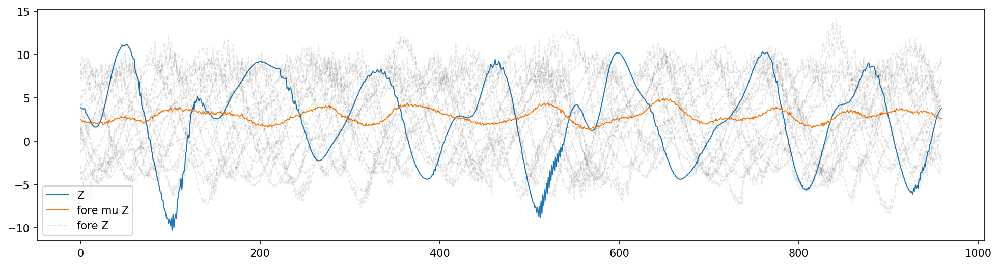

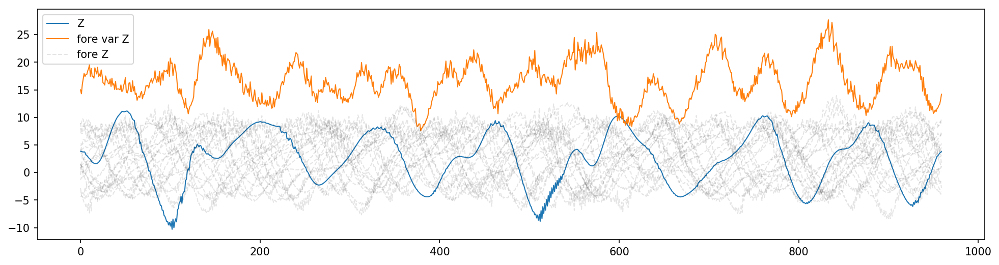

In [916]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.isel(time=0), linewidth=1)
plt.plot(np.mean(Z0_ens, axis=-1), linewidth=1)
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'fore mu Z', 'fore Z'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.isel(time=0), linewidth=1)
plt.plot(np.var(Z0_ens, axis=-1), linewidth=1)
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'fore var Z', 'fore Z'])

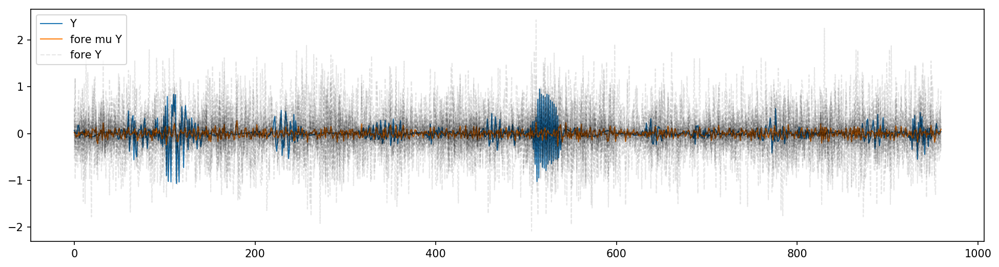

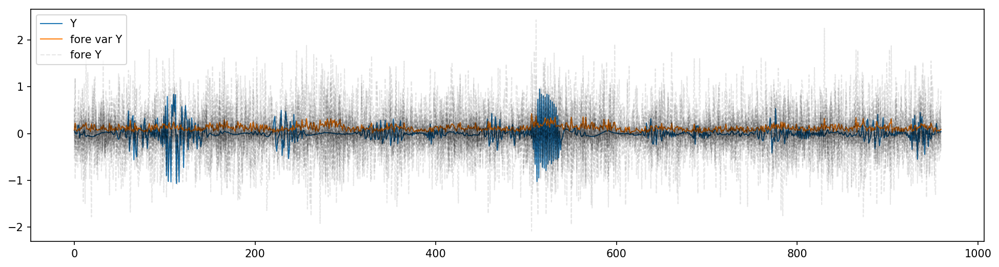

In [917]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_ts.isel(time=0), linewidth=1)
plt.plot(np.mean(Y0_ens, axis=-1), linewidth=1)
plt.plot(Y0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Y', 'fore mu Y', 'fore Y'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_ts.isel(time=0), linewidth=1)
plt.plot(np.var(Y0_ens, axis=-1), linewidth=1)
plt.plot(Y0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Y', 'fore var Y', 'fore Y'])

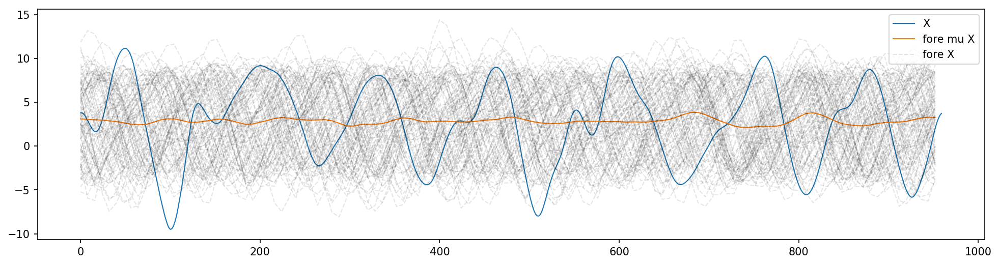

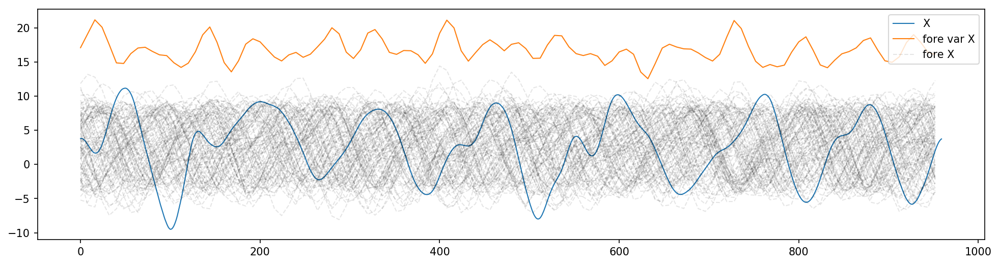

In [918]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(X_ts.isel(time=0), linewidth=1)
plt.plot(x_coar, np.mean(X0_ens, axis=-1), linewidth=1)
plt.plot(x_coar, X0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['X', 'fore mu X', 'fore X'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(X_ts.isel(time=0), linewidth=1)
plt.plot(x_coar, np.var(X0_ens, axis=-1), linewidth=1)
plt.plot(x_coar, X0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['X', 'fore var X', 'fore X'])

In [968]:
co_spacing = 8
den_patches = 15
# patch_size = 15
patch_size = 25

# Zc_obs_loc = np.arange(N_Z)[::co_spacing]
Zc_obs_loc = np.array([])

dense_patch = np.arange(-patch_size//2, patch_size//2 + 1)
dense_patch_loc = np.random.choice(N_Z, size=den_patches, replace=False)
Zd_obs_loc = dense_patch_loc[:, None] + dense_patch[None, :]
Zd_obs_loc = Zd_obs_loc.ravel() % N_Z
Zd_obs_loc = np.unique(Zd_obs_loc)
Zd_obs_loc.sort()

Z_obs_loc = np.concatenate([Zc_obs_loc, Zd_obs_loc])

N_co = Zc_obs_loc.size
N_do = Zd_obs_loc.size
print('Coarse obs size: ', N_co)
print('Dense obs size: ', N_do)

Coarse obs size:  0
Dense obs size:  319


R and H for Z

In [970]:
R_Zc_sd = 1
R_Zd_sd = 0.1
# R_Z = np.diag(np.concatenate([R_Zc_sd**2 * np.ones(N_co), R_Zd_sd**2 * np.ones(N_do)]))
R_Z = np.diag(R_Zd_sd**2 * np.ones(N_do))

# H_coar = np.eye(N_Z)[Zc_obs_loc]
H_dense = np.eye(N_Z)[Zd_obs_loc]
# H_Z = np.concatenate([H_coar, H_dense], axis=0)
H_Z = H_dense

R and H for X

In [971]:
R_Xc_sd = 1
R_Xc = (R_Xc_sd**2) * np.eye(N_Xc)
H_Xc = np.eye(N_Xc)

H_f2c = np.eye(N_Z)[::coarse]
X_obs_loc = np.arange(N_Z)[::coarse]

In [972]:
Z_obs_ts = H_Z @ Z_ts.sel(time=t_obs)
X_obs_ts = H_f2c @ X_ts.sel(time=t_obs)

In [973]:
Z_obs_ts = Z_obs_ts + np.random.multivariate_normal(np.zeros(N_co + N_do), R_Z, t_obs.size).T
X_obs_ts = X_obs_ts + np.random.multivariate_normal(np.zeros(N_Xc), R_Xc, t_obs.size).T

Z_obs_ts = xr.DataArray(Z_obs_ts,
                        dims=('loc', 'time'),
                        coords={'loc': Z_obs_loc,
                                'time': t_obs})
X_obs_ts = xr.DataArray(X_obs_ts,
                        dims=('loc', 'time'),
                        coords={'loc': X_obs_loc,
                                'time': t_obs})

In [974]:
%matplotlib inline

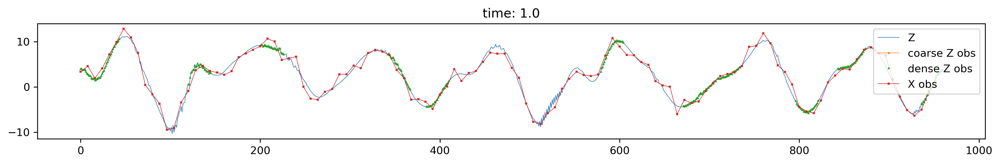

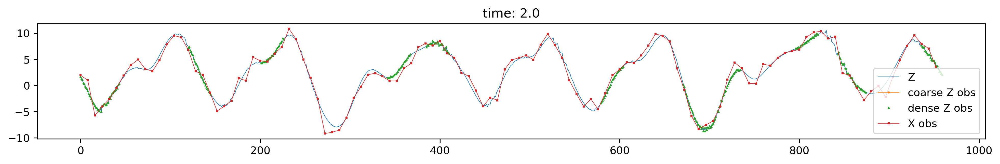

In [975]:
for at in Z_obs_ts.time.values:
    
    figsize = plt.figaspect(1/8)
    plt.figure(dpi=300, figsize=figsize)
    plt.plot(Z_ts.sel(time=at), linewidth=0.5)
    plt.plot(Zc_obs_loc, Z_obs_ts.sel(time=at).values[:N_co], '-o', markersize=1, linewidth=0.5)
    plt.plot(Zd_obs_loc, Z_obs_ts.sel(time=at).values[N_co:], '^', markersize=.75)
    plt.plot(X_obs_loc, X_obs_ts.sel(time=at), '-s', markersize=1, linewidth=0.5)
    plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'X obs'])
    plt.title(f'time: {at}')

# Assim one observation

In [1050]:
importlib.reload(assimilate)

<module 'multi_loc.assimilate' from '/home/travisharty/Documents/python_code/multi_loc/multi_loc/assimilate.py'>

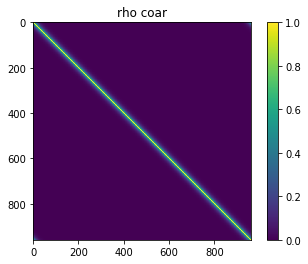

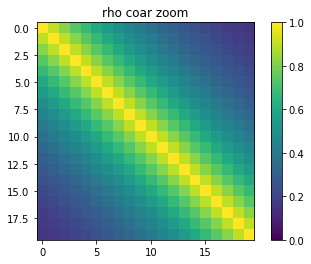

In [1060]:
rho0 = 10
# [rho_coar] = covariance.generate_circulant(N_Z, 3, rho0, covariance.correlation_exp,
#                                              return_Corr=True, return_eig=False)
# rho_coar /= rho_coar.max()
# # rho_coar = np.ones_like(rho_coar)
rho_coar = np.arange(N_Z)
rho_coar = np.minimum(np.abs(N_Z - rho_coar)%N_Z, rho_coar)
rho_coar = np.exp(-rho_coar/rho0)
# rho_coar = np.exp(-(rho_coar**2)/(2*rho0**2))
rho_coar = sp.linalg.circulant(rho_coar)

# rho_coar = np.ones_like(rho_coar)

imshow(rho_coar, 'rho coar',
       vmin=0, vmax=1)
imshow(rho_coar[:20, :20], 'rho coar zoom',
       vmin=0, vmax=1)

assim_type = 'SVD_loc'
return_details = True
X_ens_a, Z_ens_a, details = assimilate.dual_scale_enkf(
    X_ens=X0_ens, X_obs=X_obs_ts.isel(time=0).values, H_X=H_Xc, R_X=R_Xc,
    Z_ens=Z0_ens, Z_obs=Z_obs_ts.isel(time=0).values, H_Z=H_Z, R_Z=R_Z,
    H_sub=H_sub, R_sub=R_sub, coarse=coarse, rho_coar=rho_coar,
    assim_type=assim_type, return_details=return_details)

In [1066]:
print(details.keys())

dict_keys(['P_Z_sample', 'C_Z_sample', 'C_Z_ll', 'C_Z_orth', 'VT_X', 'VT_X_interp', 'C_Z_loc', 'P_Z_loc'])


In [1064]:
VT_X = details['VT_X']
VT_X_interp = details['VT_X_interp']

In [1079]:
q, r = np.linalg.qr(VT_X_interp.T)

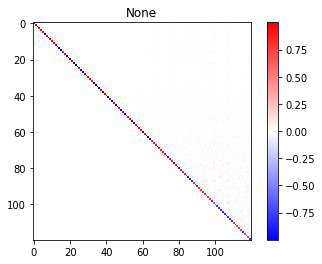

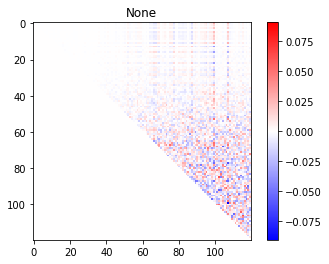

In [1092]:
vmax = np.abs(r).max()
imshow(r, vmax=vmax, vmin=-vmax, cmap='bwr')
vmax = np.abs(r - np.diag(np.diag(r))).max()
imshow(r - np.diag(np.diag(r)), vmax=vmax, vmin=-vmax, cmap='bwr')

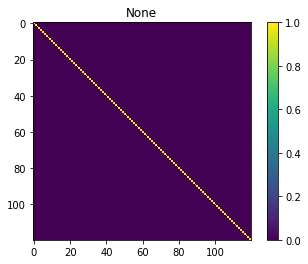

In [1083]:
imshow(q.T @ q)

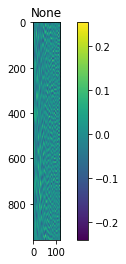

In [1081]:
imshow(q)

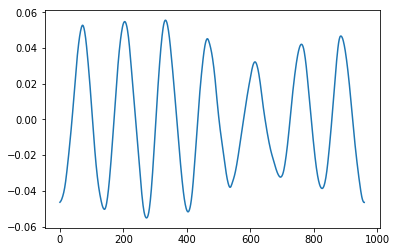

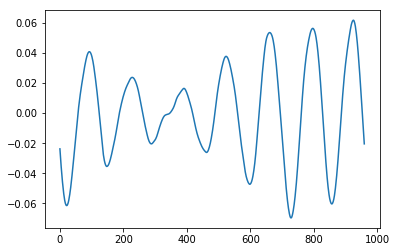

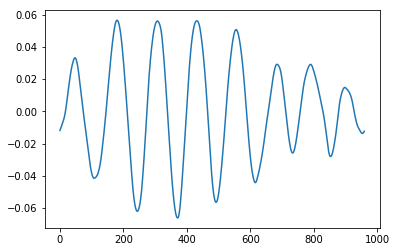

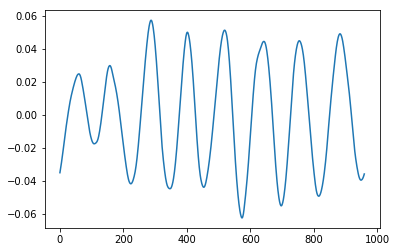

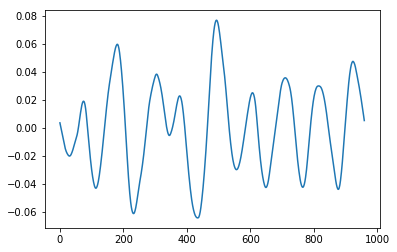

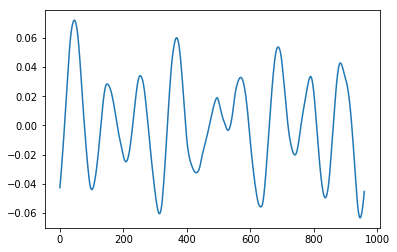

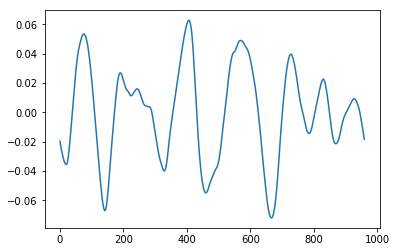

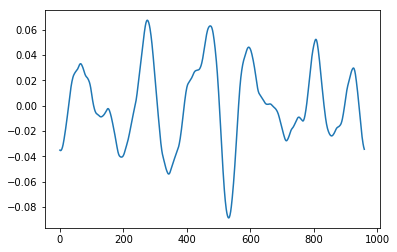

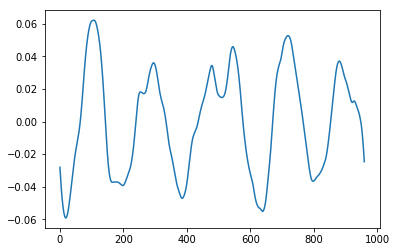

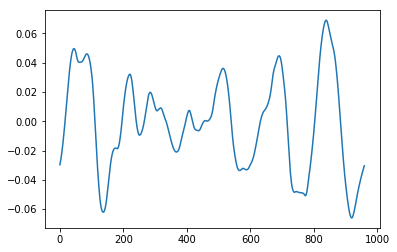

In [1093]:
for aq in q[:, :10].T:
    plt.figure()
    plt.plot(aq)

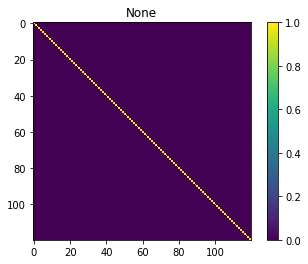

In [1077]:
imshow(q @ q.T)

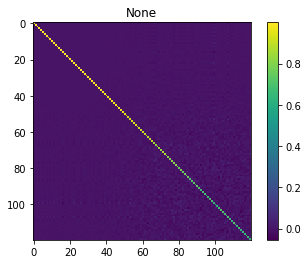

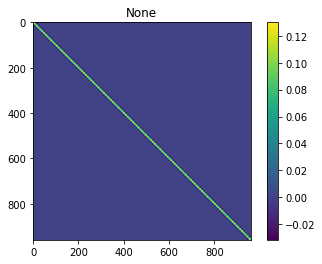

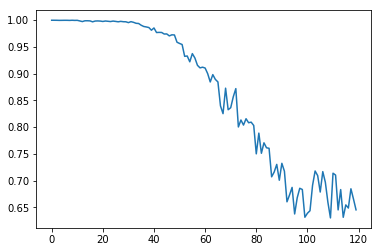

In [1070]:
imshow(VT_X_interp @ VT_X_interp.T)
imshow(VT_X_interp.T @ VT_X_interp)

plt.figure()
plt.plot(np.diag(VT_X_interp @ VT_X_interp.T))

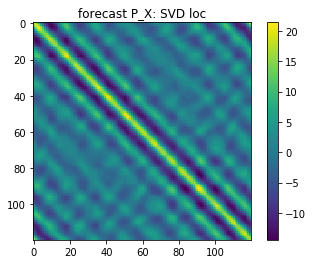

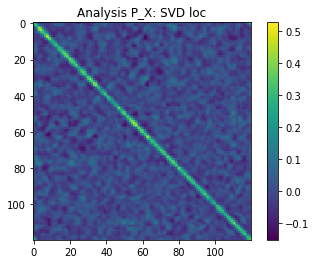

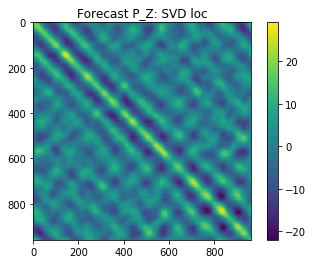

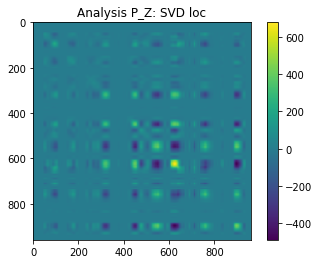

In [1057]:
P_X_f = np.cov(X0_ens)
P_X_a = np.cov(X_ens_a)
P_Z_f = np.cov(Z0_ens)
P_Z_a = np.cov(Z_ens_a)

imshow(P_X_f, f'forecast P_X: {atitle}')
imshow(P_X_a, f'Analysis P_X: {atitle}')
imshow(P_Z_f, f'Forecast P_Z: {atitle}')
imshow(P_Z_a, f'Analysis P_Z: {atitle}')

In [1058]:
%matplotlib inline

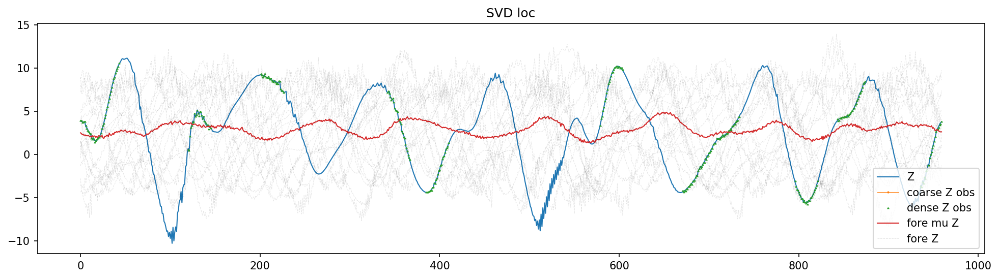

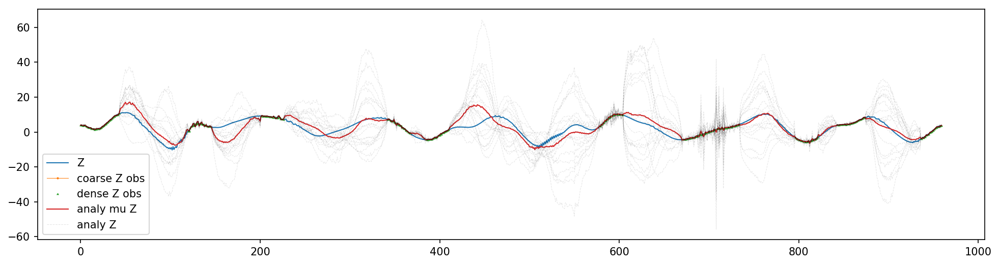

In [1059]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.isel(time=0), linewidth=1)
plt.plot(Zc_obs_loc, Z_obs_ts.isel(time=0).values[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs_ts.isel(time=0).values[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z0_ens, axis=-1), linewidth=1)
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=0.5)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore mu Z', 'fore Z'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.isel(time=0), linewidth=1)
plt.plot(Zc_obs_loc, Z_obs_ts.isel(time=0).values[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs_ts.isel(time=0).values[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z_ens_a, axis=-1), linewidth=1)
plt.plot(Z_ens_a, 'k--', alpha=.1, linewidth=0.5)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy mu Z', 'analy Z'])

# mu = np.mean(Z_ens_a, axis=-1)
# rmse = np.sqrt(((mu - Z_GT[:, 0])**2).mean())
# plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')

# Use SVD localization

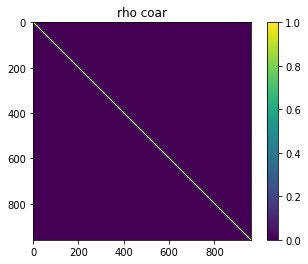

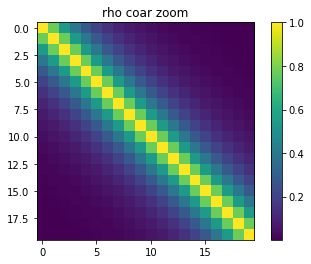

In [516]:
[rho_coar] = covariance.generate_circulant(N_Z, 1, 3, covariance.fft_exp_1d,
                                             return_Corr=True, return_eig=False)
rho_coar /= rho_coar.max()
imshow(rho_coar, 'rho coar')
imshow(rho_coar[:20, :20], 'rho coar zoom')

cycle_dict = {'X0_ens': X0_ens, 'Z0_ens': Z0_ens,
              'X_obs_ts': X_obs_ts, 'Z_obs_ts': Z_obs_ts,
              'R_X': R_Xc, 'R_Z': R_Z,
              'H_X': H_Xc, 'H_Z': H_Z,
              'dt': dt,
              'coarse': coarse,
              'rho_coar': rho_coar,
              'H_sub': H_sub, 'R_sub': R_sub}

In [517]:
importlib.reload(assimilate)
importlib.reload(utilities)

Xa_ens_ts, Za_ens_ts = assimilate.cycle_KF_LM3(**cycle_dict)

10.0
assimed


/home/travisharty/anaconda3/envs/loc/lib/python3.7/site-packages/scipy/integrate/odepack.py:236: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


pushed Z


/home/travisharty/Documents/python_code/multi_loc/multi_loc/utilities.py:356: RuntimeWarning: overflow encountered in multiply
  T1 = -1 * np.roll(X, 2, axis=0) * np.roll(X, 1, axis=0)
/home/travisharty/Documents/python_code/multi_loc/multi_loc/utilities.py:357: RuntimeWarning: overflow encountered in multiply
  T2 = np.roll(X, 1, axis=0) * np.roll(X, -1, axis=0)
/home/travisharty/Documents/python_code/multi_loc/multi_loc/utilities.py:358: RuntimeWarning: invalid value encountered in add
  return T1 + T2
/home/travisharty/Documents/python_code/multi_loc/multi_loc/utilities.py:346: RuntimeWarning: overflow encountered in multiply
  T1 = -1 * np.roll(X, 2, axis=0) * np.roll(Y, 1, axis=0)
/home/travisharty/Documents/python_code/multi_loc/multi_loc/utilities.py:347: RuntimeWarning: overflow encountered in multiply
  T2 = np.roll(X, 1, axis=0) * np.roll(Y, -1, axis=0)
/home/travisharty/Documents/python_code/multi_loc/multi_loc/utilities.py:348: RuntimeWarning: invalid value encountered in a

IndexError: index 21 is out of bounds for axis 2 with size 21

In [ ]:
atitle='SVD loc'

In [ ]:
this_time = 0

this_ens = Z0_ens

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.sel(time=this_time), linewidth=1)
plt.plot(Zc_obs_loc, Z_obs_ts.sel(time=this_time)[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs_ts.sel(time=this_time)[N_co:], '^', markersize=.75)
plt.plot(np.mean(this_ens, axis=-1), linewidth=1)
plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore mu Z', 'fore Z'])

mu = np.mean(this_ens, axis=-1)
rmse = np.sqrt(((mu - Z_ts.sel(time=this_time).values)**2).mean())
plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')


this_time = 0

this_ens = Za_ens_ts[0].sel(time=this_time).values

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.sel(time=this_time), linewidth=1)
plt.plot(Zc_obs_loc, Z_obs_ts.sel(time=0)[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs_ts.sel(time=0)[N_co:], '^', markersize=.75)
plt.plot(np.mean(this_ens, axis=-1), linewidth=1)
plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy mu Z', 'analy Z'])

mu = np.mean(this_ens, axis=-1)
rmse = np.sqrt(((mu - Z_GT[:, 0])**2).mean())
plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')

In [ ]:
this_array = np.array([0.5, 1, 1.5, 2, 2.5, 3, 3.5], dtype=float)
for count, this_time in enumerate(this_array):
    this_ens = Za_ens_ts[count].sel(time=this_time).values

    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_ts.sel(time=this_time), linewidth=1)
    plt.plot(Zc_obs_loc, Z_obs_ts.sel(time=this_time)[:N_co], '-o', markersize=1, linewidth=0.5)
    plt.plot(Zd_obs_loc, Z_obs_ts.sel(time=this_time)[N_co:], '^', markersize=.75)
    plt.plot(np.mean(this_ens, axis=-1), linewidth=1)
    plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
    plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore mu Z', 'fore Z'])

    mu = np.mean(this_ens, axis=-1)
    rmse = np.sqrt(((mu - Z_ts.sel(time=this_time).values)**2).mean())
    plt.title(f'Z forecast ({this_time:0.2}) with {atitle}; rmse: {rmse:0.4}')

    
    this_ens = Za_ens_ts[count + 1].sel(time=this_time).values

    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_ts.sel(time=this_time), linewidth=1)
    plt.plot(Zc_obs_loc, Z_obs_ts.sel(time=this_time)[:N_co], '-o', markersize=1, linewidth=0.5)
    plt.plot(Zd_obs_loc, Z_obs_ts.sel(time=this_time)[N_co:], '^', markersize=.75)
    plt.plot(np.mean(this_ens, axis=-1), linewidth=1)
    plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
    plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy mu Z', 'analy Z'])

    mu = np.mean(this_ens, axis=-1)
    rmse = np.sqrt(((mu - Z_ts.sel(time=this_time).values)**2).mean())
    plt.title(f'Z analysis ({this_time:0.2}) with {atitle}; rmse: {rmse:0.4}')

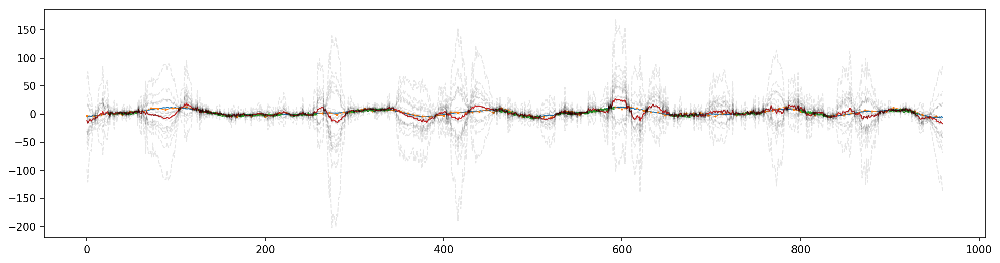

In [140]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT_kf[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs_ts[:N_co, 0], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs_ts[N_co:, 0], '^', markersize=.75)
plt.plot(np.mean(Za_ens_ts[0][:, :, 0], axis=-1), linewidth=1)
plt.plot(Za_ens_ts[0][:, :, 0], 'k--', alpha=.1, linewidth=1)
# plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore mu Z', 'fore Z'])
# plt.title(atitle)


# figsize = plt.figaspect(1/4)
# plt.figure(dpi=150, figsize=figsize)
# plt.plot(Z_GT[:, 0], linewidth=1)
# plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
# plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
# plt.plot(np.mean(Z_ens_a, axis=-1), linewidth=1)
# plt.plot(Z_ens_a, 'k--', alpha=.1, linewidth=1)
# plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy mu Z', 'analy Z'])

# mu = np.mean(Z_ens_a, axis=-1)
# rmse = np.sqrt(((mu - Z_GT[:, 0])**2).mean())
# plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')

In [124]:
len(Xa_ens_ts)

3

In [127]:
Za_ens_ts[0].shape

(960, 20, 21)

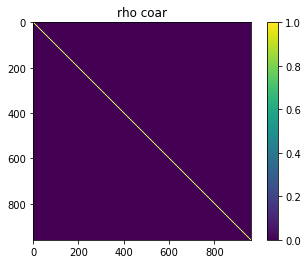

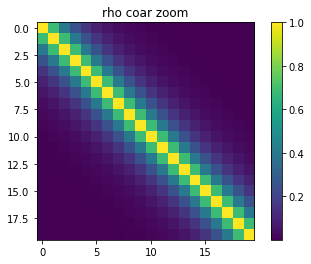

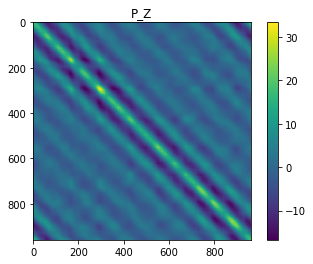

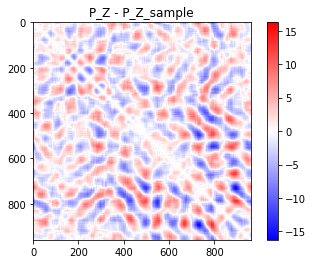

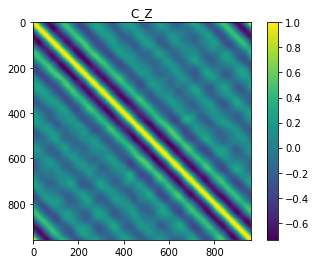

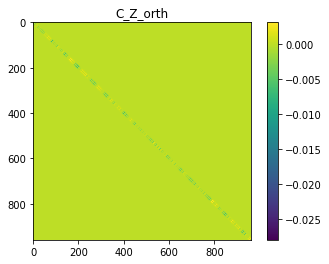

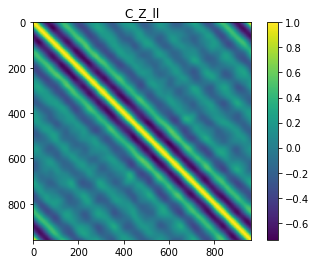

In [1591]:
importlib.reload(assimilate)

[rho_coar] = covariance.generate_circulant(N_Z, 1, 2, covariance.fft_exp_1d,
                                             return_Corr=True, return_eig=False)
rho_coar /= rho_coar.max()
imshow(rho_coar, 'rho coar')
imshow(rho_coar[:20, :20], 'rho coar zoom')

X_ens_a, Z_ens_a = assimilate.dual_scale_enkf(
    X_ens=X0_ens, X_obs=X_obs, H_X=H_Xc, R_X=R_Xc,
    Z_ens=Z0_ens, Z_obs=Z_obs, H_Z=H_Z, R_Z=R_Z,
    H_sub=H_sub, R_sub=R_sub, coarse=coarse, rho_coar=rho_coar)

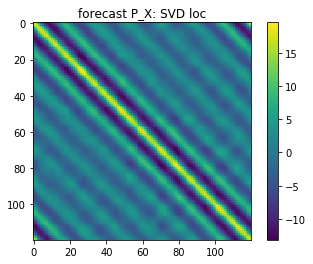

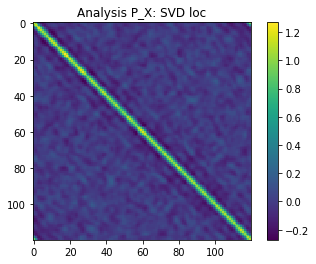

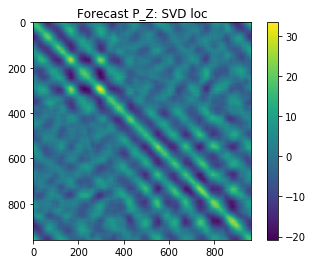

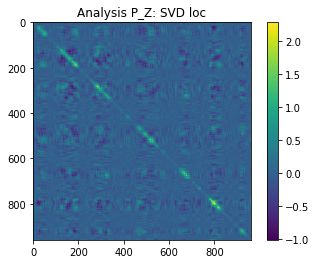

In [1592]:
P_X_f = np.cov(X0_ens)
P_X_a = np.cov(X_ens_a)
P_Z_f = np.cov(Z0_ens)
P_Z_a = np.cov(Z_ens_a)

imshow(P_X_f, f'forecast P_X: {atitle}')
imshow(P_X_a, f'Analysis P_X: {atitle}')
imshow(P_Z_f, f'Forecast P_Z: {atitle}')
imshow(P_Z_a, f'Analysis P_Z: {atitle}')

Text(0.5,1,'Z analysis with SVD loc; rmse: 0.7087')

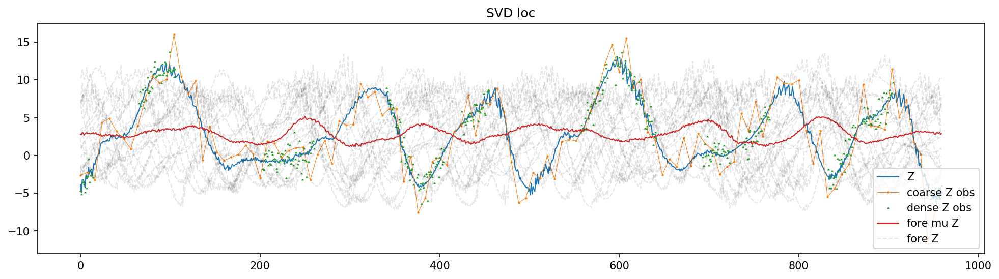

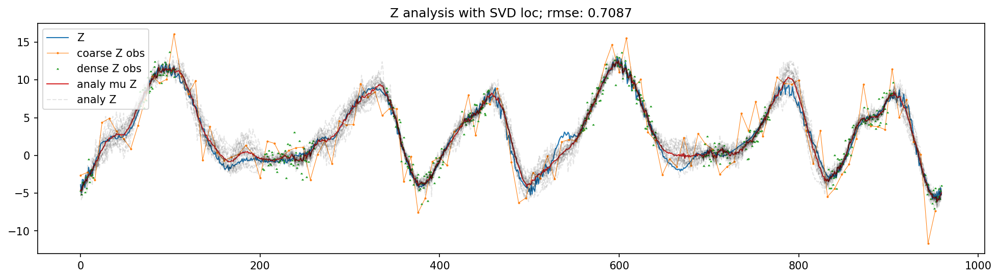

In [1593]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z0_ens, axis=-1), linewidth=1)
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore mu Z', 'fore Z'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z_ens_a, axis=-1), linewidth=1)
plt.plot(Z_ens_a, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy mu Z', 'analy Z'])

mu = np.mean(Z_ens_a, axis=-1)
rmse = np.sqrt(((mu - Z_GT[:, 0])**2).mean())
plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'Z analysis with SVD loc; rmse: 0.7087')

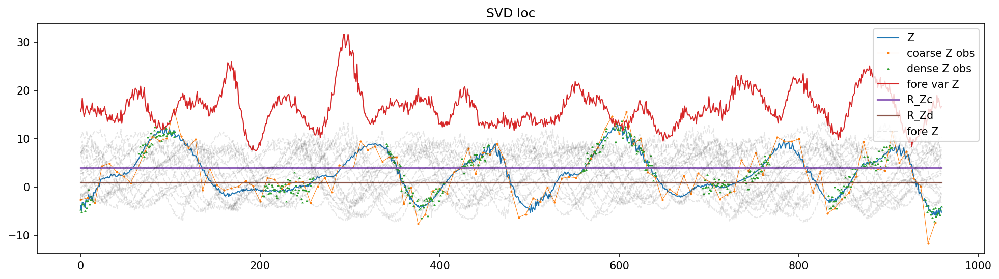

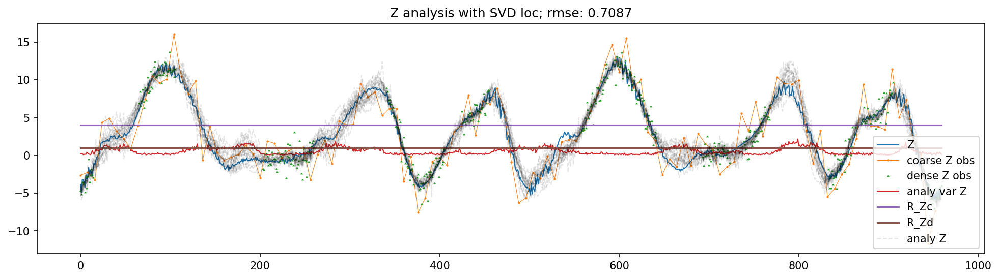

In [1594]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.var(Z0_ens, axis=-1), linewidth=1)
plt.plot(R_Zc_sd**2 * np.ones_like(Z_GT[:, 0]))
plt.plot(R_Zd_sd**2 * np.ones_like(Z_GT[:, 0]))
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore var Z', 'R_Zc', 'R_Zd', 'fore Z'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.var(Z_ens_a, axis=-1), linewidth=1)
plt.plot(R_Zc_sd**2 * np.ones_like(Z_GT[:, 0]))
plt.plot(R_Zd_sd**2 * np.ones_like(Z_GT[:, 0]))
plt.plot(Z_ens_a, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy var Z', 'R_Zc', 'R_Zd', 'analy Z'])

mu = np.mean(Z_ens_a, axis=-1)
rmse = np.sqrt(((mu - Z_GT[:, 0])**2).mean())
plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'Y analysis with SVD loc; rmse: 0.3228')

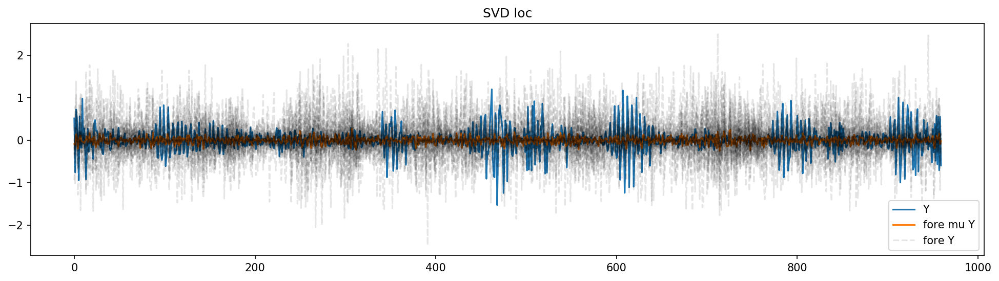

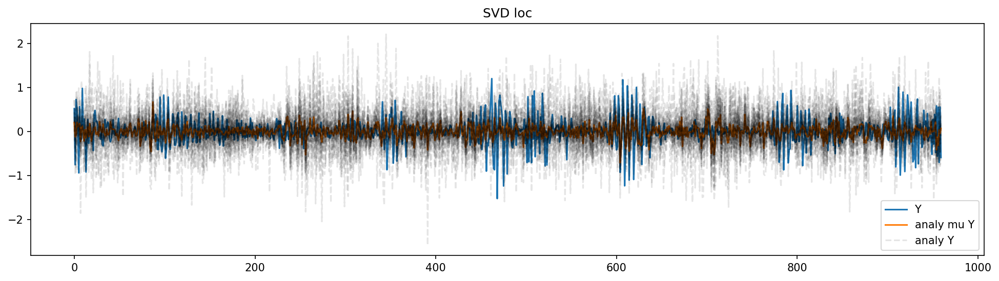

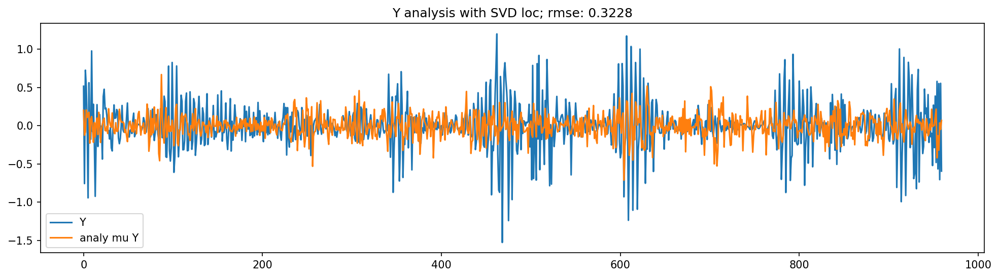

In [1595]:
this_X_ens_f = utilities.window_sum_Z(Z0_ens, I=I, alpha=alpha, beta=beta)
this_Y_ens_f = Z0_ens - this_X_ens_f

this_X_ens_a = utilities.window_sum_Z(Z_ens_a, I=I, alpha=alpha, beta=beta)
this_Y_ens_a = Z_ens_a - this_X_ens_a


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_f, axis=-1))
plt.plot(this_Y_ens_f, 'k--', alpha=.1)
plt.legend(['Y', 'fore mu Y', 'fore Y'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_a, axis=-1))
plt.plot(this_Y_ens_a, 'k--', alpha=.1)
plt.legend(['Y', 'analy mu Y', 'analy Y'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_a, axis=-1))
plt.legend(['Y', 'analy mu Y'])

mu = np.mean(this_Y_ens_a, axis=-1)
rmse = np.sqrt(((mu - Y_GT[:, 0])**2).mean())
plt.title(f'Y analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'Y analysis with SVD loc; rmse: 11.41')

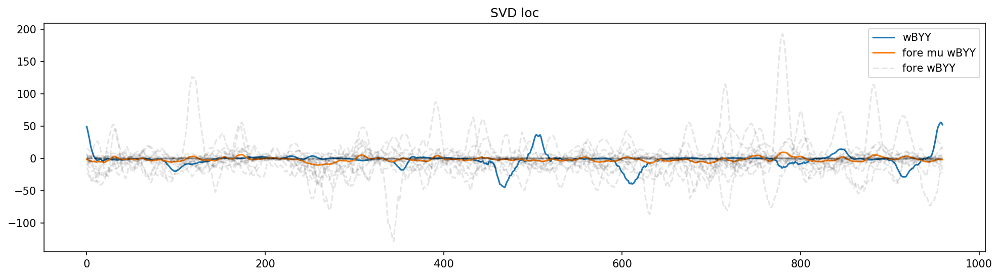

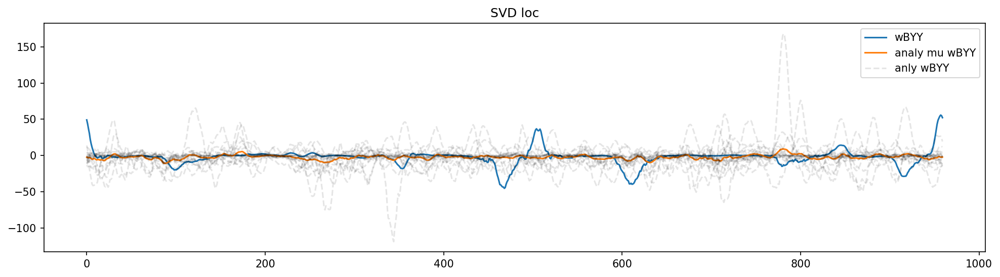

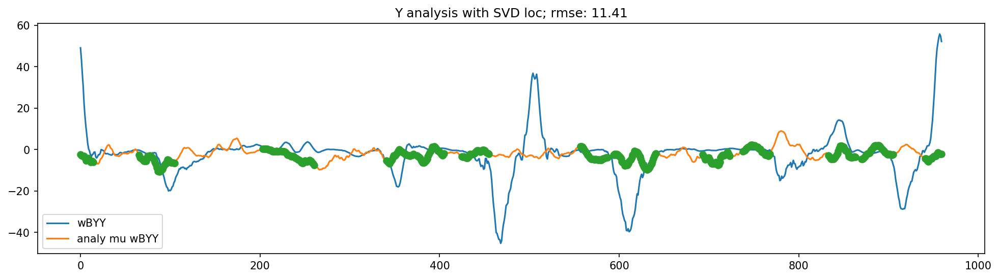

In [1596]:
BYY_GT = b**2 * utilities.bracket([Y_GT[:, 0]], 1)
wBYY_GT = utilities.window_sum_Z(BYY_GT, I=I, alpha=alpha, beta=beta)

BYY_ens_f = b**2 * utilities.bracket([this_Y_ens_f], 1)
wBYY_ens_f = utilities.window_sum_Z(BYY_ens_f, I=I, alpha=alpha, beta=beta)

BYY_ens_a = b**2 * utilities.bracket([this_Y_ens_a], 1)
wBYY_ens_a = utilities.window_sum_Z(BYY_ens_a, I=I, alpha=alpha, beta=beta)

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_f, axis=-1))
plt.plot(wBYY_ens_f, 'k--', alpha=.1)
plt.legend(['wBYY', 'fore mu wBYY', 'fore wBYY'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_a, axis=-1))
plt.plot(wBYY_ens_a, 'k--', alpha=.1)
plt.legend(['wBYY', 'analy mu wBYY', 'anly wBYY'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_a, axis=-1))
plt.plot(Zd_obs_loc, np.mean(wBYY_ens_a, axis=-1)[Zd_obs_loc], 'o')
plt.legend(['wBYY', 'analy mu wBYY'])

mu = np.mean(wBYY_ens_a, axis=-1)
rmse = np.sqrt(((mu - wBYY_GT)**2).mean())
plt.title(f'Y analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'SVD loc')

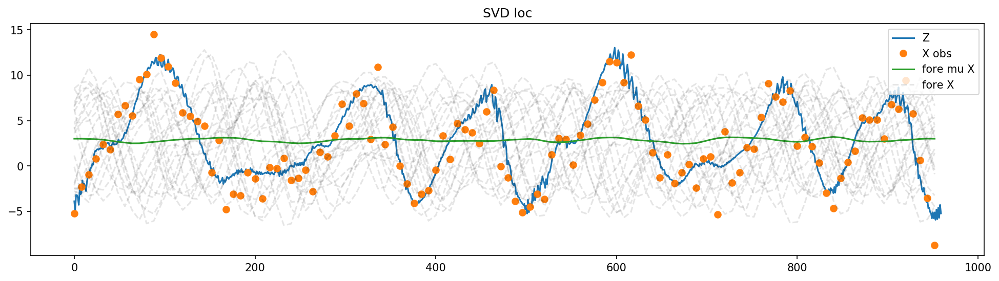

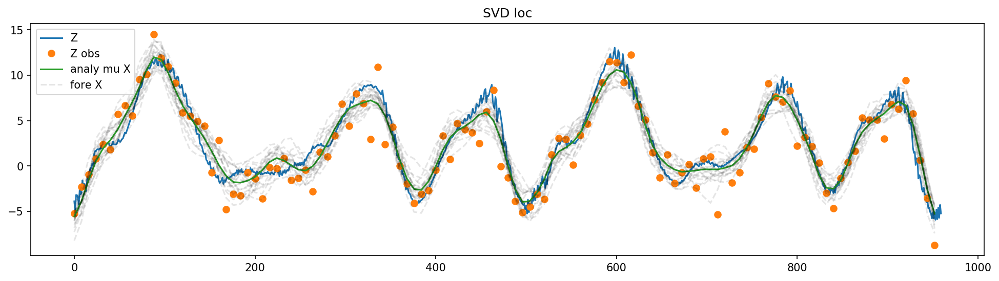

In [1597]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X0_ens, axis=-1))
plt.plot(x_coar, X0_ens[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'X obs', 'fore mu X', 'fore X'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X_ens_a, axis=-1))
plt.plot(x_coar, X_ens_a[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'analy mu X', 'fore X'])
plt.title(atitle)

# Use correlation diff loc

In [1598]:
atitle = 'corr diff'

rho_coar


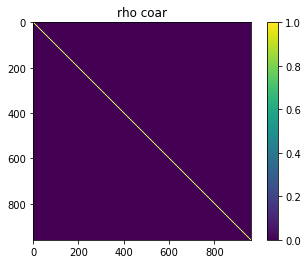

In [1599]:
importlib.reload(assimilate)

# [rho_coar] = covariance.generate_circulant(N_Z, 1, 500, covariance.fft_sqd_exp_1d,
#                                              return_Corr=True, return_eig=False)
# rho_coar /= rho_coar.max()
imshow(rho_coar, 'rho coar', vmin=0, vmax=1)

use_SVD_loc = False
use_corr_diff = True


X_ens_a, Z_ens_a = assimilate.dual_scale_enkf(
    X_ens=X0_ens, X_obs=X_obs, H_X=H_Xc, R_X=R_Xc,
    Z_ens=Z0_ens, Z_obs=Z_obs, H_Z=H_Z, R_Z=R_Z,
    H_sub=H_sub, R_sub=R_sub, coarse=coarse, rho_coar=rho_coar,
    use_SVD_loc=use_SVD_loc, use_corr_diff=use_corr_diff)

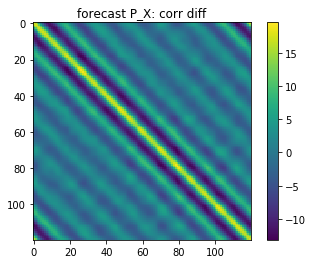

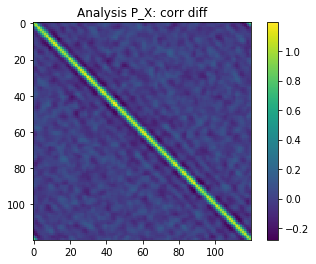

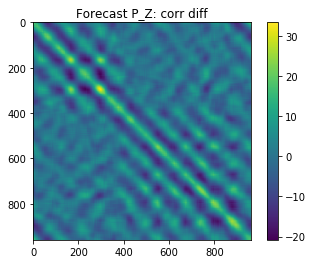

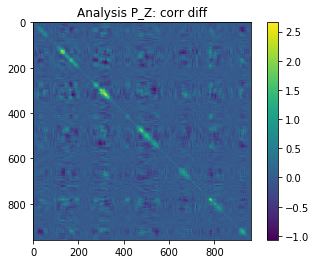

In [1600]:
P_X_f = np.cov(X0_ens)
P_X_a = np.cov(X_ens_a)
P_Z_f = np.cov(Z0_ens)
P_Z_a = np.cov(Z_ens_a)

imshow(P_X_f, f'forecast P_X: {atitle}')
imshow(P_X_a, f'Analysis P_X: {atitle}')
imshow(P_Z_f, f'Forecast P_Z: {atitle}')
imshow(P_Z_a, f'Analysis P_Z: {atitle}')

Text(0.5,1,'Z analysis with corr diff; rmse: 0.767')

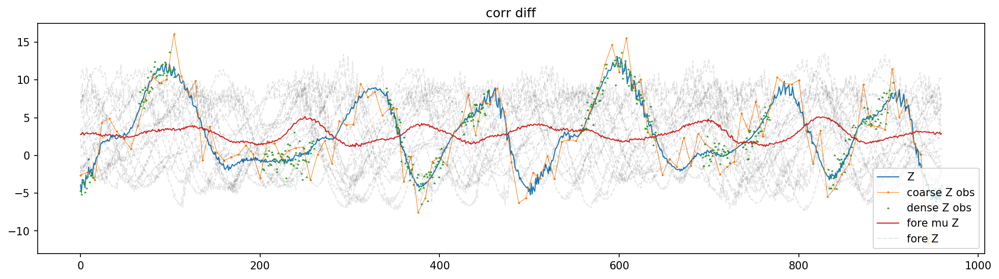

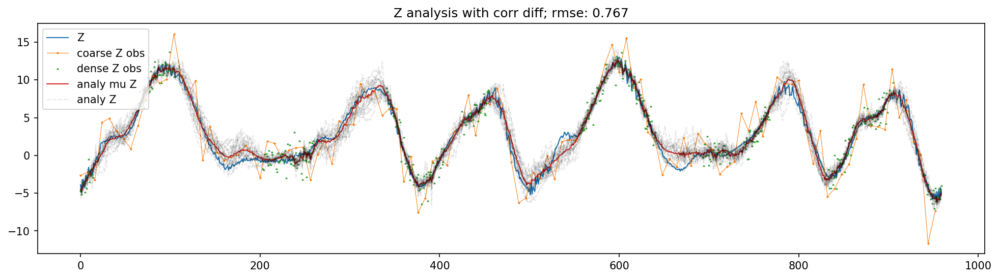

In [1601]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z0_ens, axis=-1), linewidth=1)
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore mu Z', 'fore Z'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z_ens_a, axis=-1), linewidth=1)
plt.plot(Z_ens_a, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy mu Z', 'analy Z'])

mu = np.mean(Z_ens_a, axis=-1)
rmse = np.sqrt(((mu - Z_GT[:, 0])**2).mean())
plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'Z analysis with corr diff; rmse: 0.767')

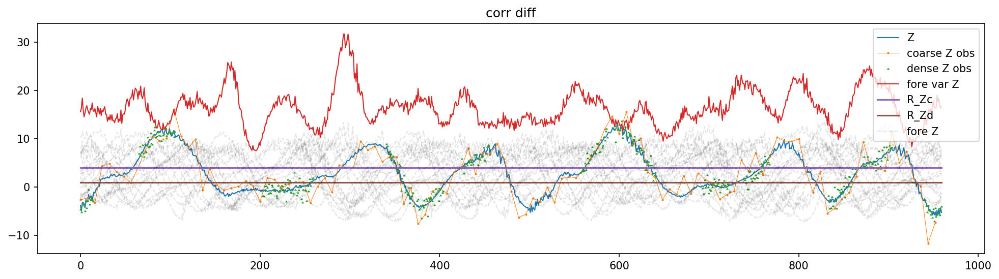

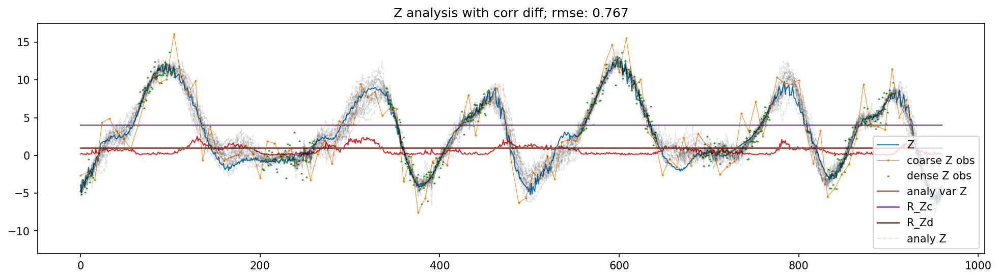

In [1602]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.var(Z0_ens, axis=-1), linewidth=1)
plt.plot(R_Zc_sd**2 * np.ones_like(Z_GT[:, 0]))
plt.plot(R_Zd_sd**2 * np.ones_like(Z_GT[:, 0]))
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore var Z', 'R_Zc', 'R_Zd', 'fore Z'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.var(Z_ens_a, axis=-1), linewidth=1)
plt.plot(R_Zc_sd**2 * np.ones_like(Z_GT[:, 0]))
plt.plot(R_Zd_sd**2 * np.ones_like(Z_GT[:, 0]))
plt.plot(Z_ens_a, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy var Z', 'R_Zc', 'R_Zd', 'analy Z'])

mu = np.mean(Z_ens_a, axis=-1)
rmse = np.sqrt(((mu - Z_GT[:, 0])**2).mean())
plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'Y analysis with corr diff; rmse: 0.3249')

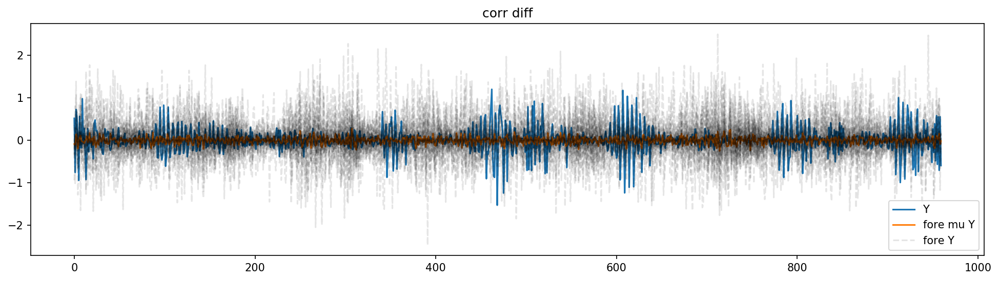

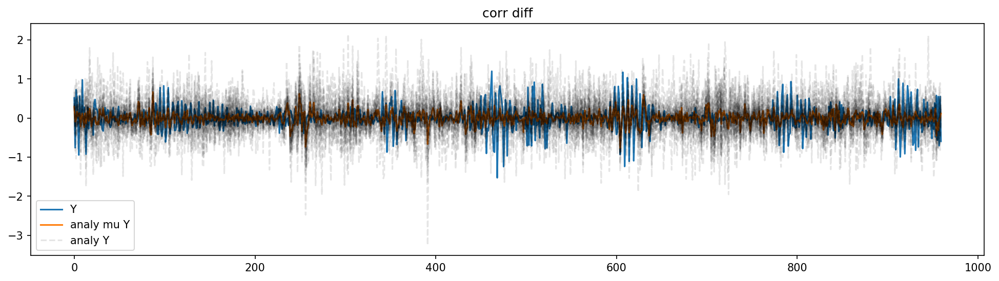

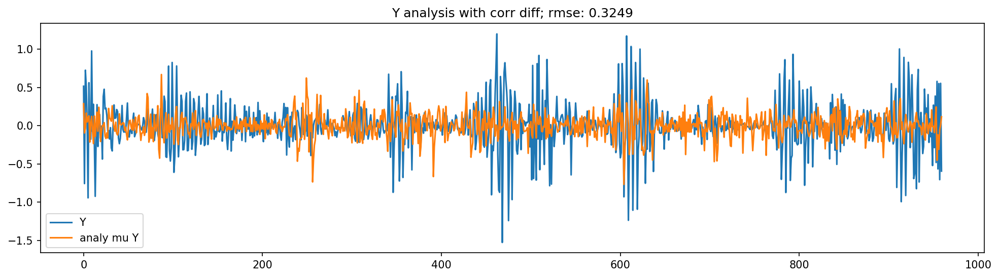

In [1603]:
this_X_ens_f = utilities.window_sum_Z(Z0_ens, I=I, alpha=alpha, beta=beta)
this_Y_ens_f = Z0_ens - this_X_ens_f

this_X_ens_a = utilities.window_sum_Z(Z_ens_a, I=I, alpha=alpha, beta=beta)
this_Y_ens_a = Z_ens_a - this_X_ens_a


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_f, axis=-1))
plt.plot(this_Y_ens_f, 'k--', alpha=.1)
plt.legend(['Y', 'fore mu Y', 'fore Y'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_a, axis=-1))
plt.plot(this_Y_ens_a, 'k--', alpha=.1)
plt.legend(['Y', 'analy mu Y', 'analy Y'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_a, axis=-1))
plt.legend(['Y', 'analy mu Y'])

mu = np.mean(this_Y_ens_a, axis=-1)
rmse = np.sqrt(((mu - Y_GT[:, 0])**2).mean())
plt.title(f'Y analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'Y analysis with corr diff; rmse: 11.51')

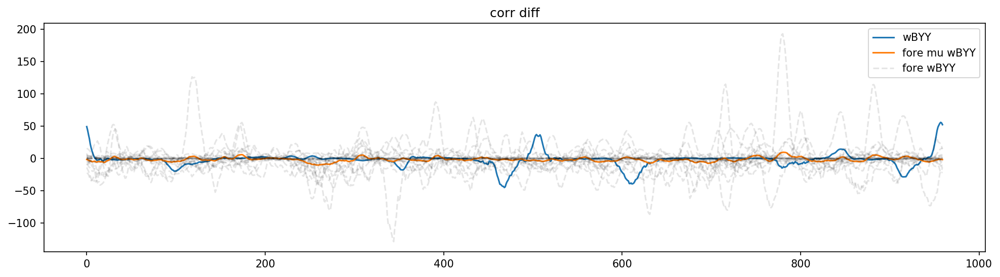

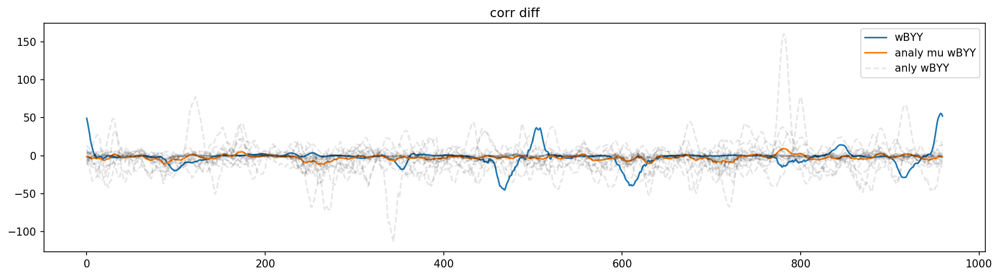

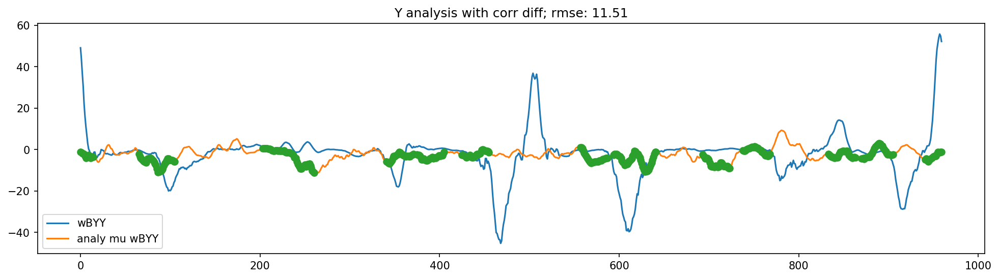

In [1604]:
BYY_GT = b**2 * utilities.bracket([Y_GT[:, 0]], 1)
wBYY_GT = utilities.window_sum_Z(BYY_GT, I=I, alpha=alpha, beta=beta)

BYY_ens_f = b**2 * utilities.bracket([this_Y_ens_f], 1)
wBYY_ens_f = utilities.window_sum_Z(BYY_ens_f, I=I, alpha=alpha, beta=beta)

BYY_ens_a = b**2 * utilities.bracket([this_Y_ens_a], 1)
wBYY_ens_a = utilities.window_sum_Z(BYY_ens_a, I=I, alpha=alpha, beta=beta)

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_f, axis=-1))
plt.plot(wBYY_ens_f, 'k--', alpha=.1)
plt.legend(['wBYY', 'fore mu wBYY', 'fore wBYY'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_a, axis=-1))
plt.plot(wBYY_ens_a, 'k--', alpha=.1)
plt.legend(['wBYY', 'analy mu wBYY', 'anly wBYY'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_a, axis=-1))
plt.plot(Zd_obs_loc, np.mean(wBYY_ens_a, axis=-1)[Zd_obs_loc], 'o')
plt.legend(['wBYY', 'analy mu wBYY'])

mu = np.mean(wBYY_ens_a, axis=-1)
rmse = np.sqrt(((mu - wBYY_GT)**2).mean())
plt.title(f'Y analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'corr diff')

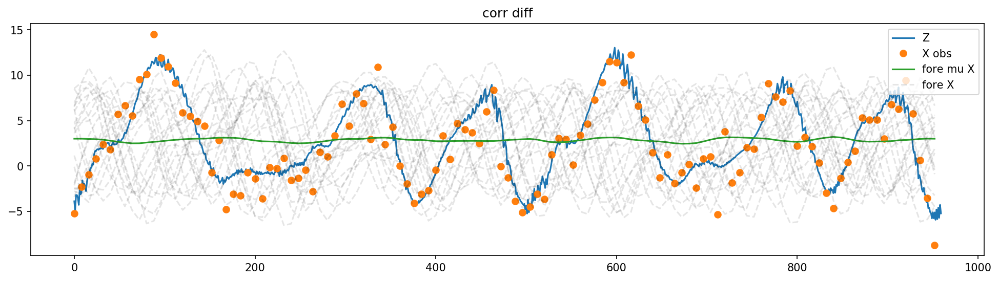

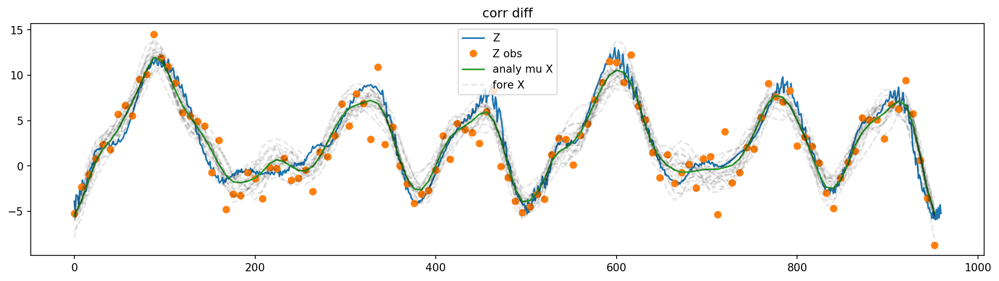

In [1605]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X0_ens, axis=-1))
plt.plot(x_coar, X0_ens[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'X obs', 'fore mu X', 'fore X'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X_ens_a, axis=-1))
plt.plot(x_coar, X_ens_a[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'analy mu X', 'fore X'])
plt.title(atitle)

# With standard localization

In [1606]:
atitle = 'standard loc'

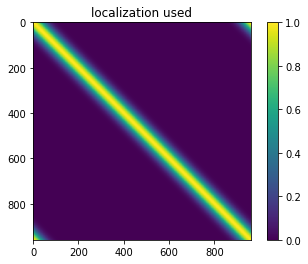

In [1607]:
use_SVD_loc = False
[loc] = covariance.generate_circulant(N_Z, 1, 35, covariance.fft_sqd_exp_1d, return_Corr=True, return_eig=False)
imshow(loc, title='localization used')

X_ens_a, Z_ens_a = assimilate.dual_scale_enkf(
    X_ens=X0_ens, X_obs=X_obs, H_X=H_Xc, R_X=R_Xc,
    Z_ens=Z0_ens, Z_obs=Z_obs, H_Z=H_Z, R_Z=R_Z,
    H_sub=H_sub, R_sub=R_sub, coarse=coarse, use_SVD_loc=use_SVD_loc,
    rho=loc)

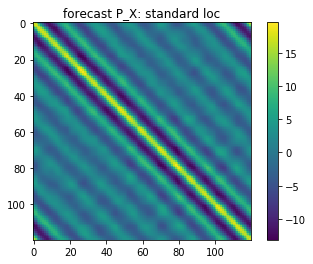

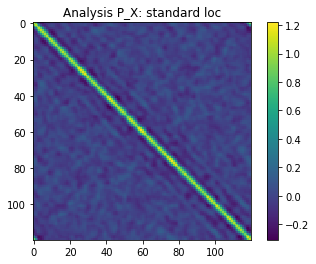

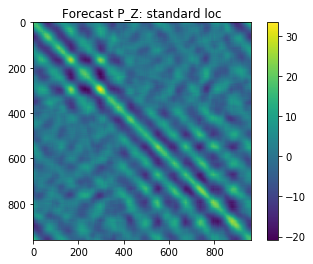

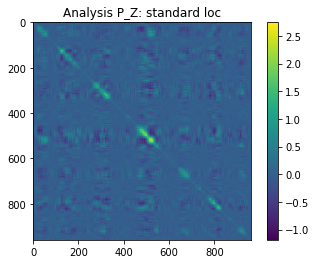

In [1608]:
P_X_f = np.cov(X0_ens)
P_X_a = np.cov(X_ens_a)
P_Z_f = np.cov(Z0_ens)
P_Z_a = np.cov(Z_ens_a)

imshow(P_X_f, f'forecast P_X: {atitle}')
imshow(P_X_a, f'Analysis P_X: {atitle}')
imshow(P_Z_f, f'Forecast P_Z: {atitle}')
imshow(P_Z_a, f'Analysis P_Z: {atitle}')

Text(0.5,1,'Z analysis with standard loc; rmse: 0.7132')

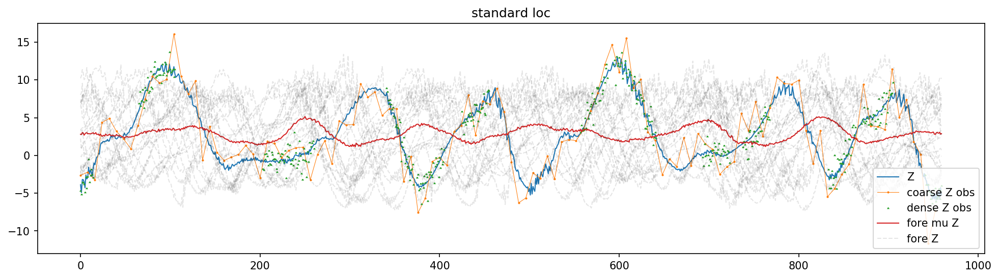

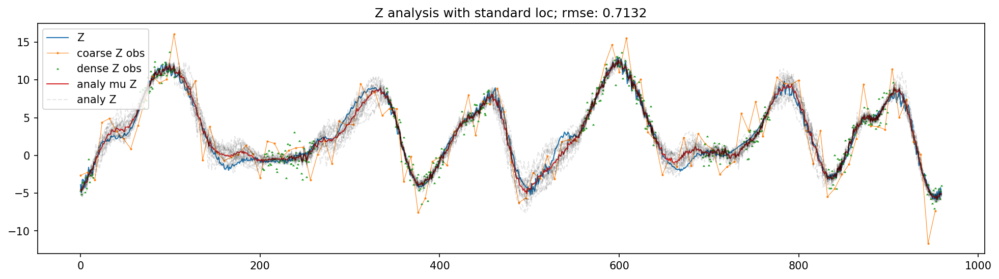

In [1609]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z0_ens, axis=-1), linewidth=1)
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore mu Z', 'fore Z'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z_ens_a, axis=-1), linewidth=1)
plt.plot(Z_ens_a, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy mu Z', 'analy Z'])

mu = np.mean(Z_ens_a, axis=-1)
rmse = np.sqrt(((mu - Z_GT[:, 0])**2).mean())
plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'Z analysis with standard loc; rmse: 0.7132')

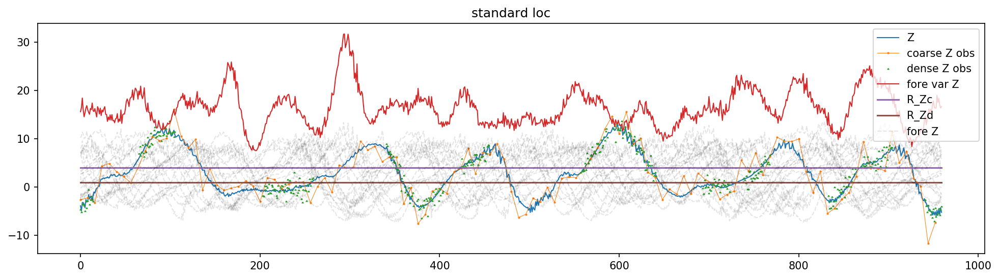

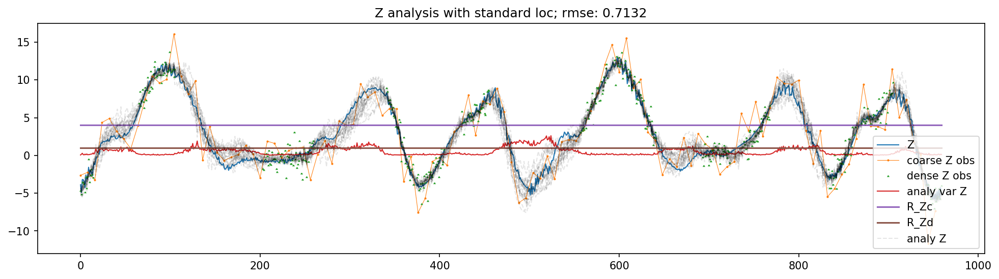

In [1610]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.var(Z0_ens, axis=-1), linewidth=1)
plt.plot(R_Zc_sd**2 * np.ones_like(Z_GT[:, 0]))
plt.plot(R_Zd_sd**2 * np.ones_like(Z_GT[:, 0]))
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore var Z', 'R_Zc', 'R_Zd', 'fore Z'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.var(Z_ens_a, axis=-1), linewidth=1)
plt.plot(R_Zc_sd**2 * np.ones_like(Z_GT[:, 0]))
plt.plot(R_Zd_sd**2 * np.ones_like(Z_GT[:, 0]))
plt.plot(Z_ens_a, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy var Z', 'R_Zc', 'R_Zd', 'analy Z'])

mu = np.mean(Z_ens_a, axis=-1)
rmse = np.sqrt(((mu - Z_GT[:, 0])**2).mean())
plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'Y analysis with standard loc; rmse: 0.3495')

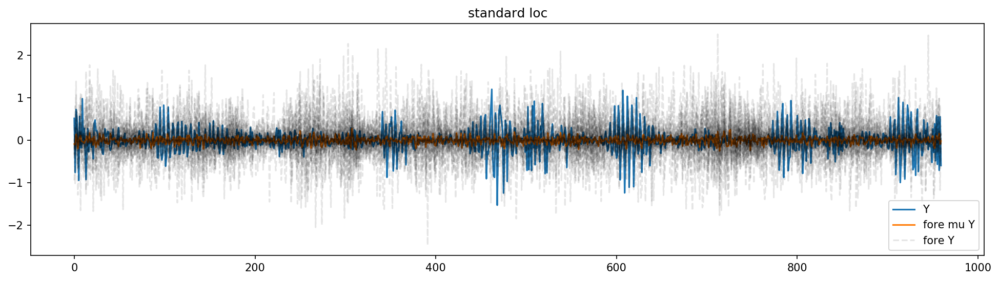

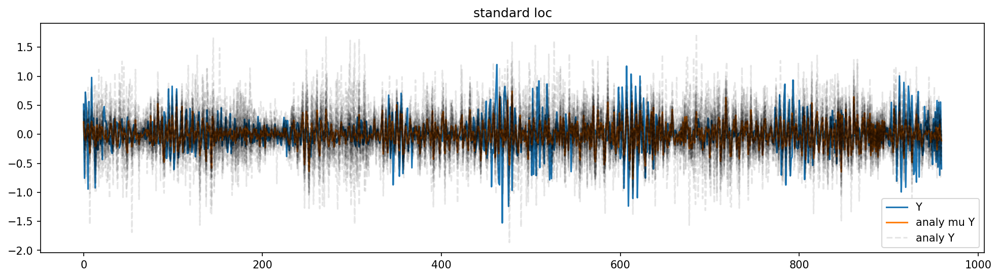

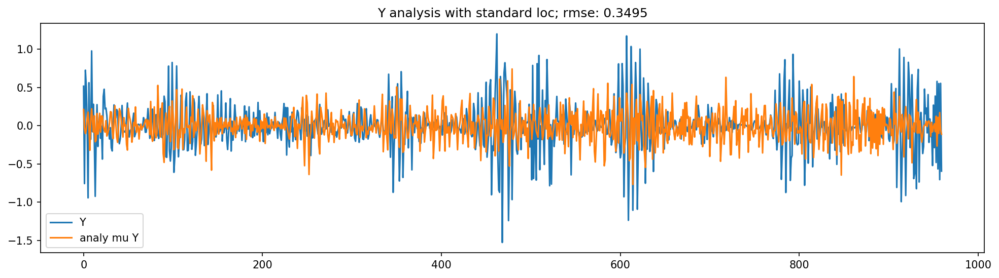

In [1611]:
this_X_ens_f = utilities.window_sum_Z(Z0_ens, I=I, alpha=alpha, beta=beta)
this_Y_ens_f = Z0_ens - this_X_ens_f

this_X_ens_a = utilities.window_sum_Z(Z_ens_a, I=I, alpha=alpha, beta=beta)
this_Y_ens_a = Z_ens_a - this_X_ens_a


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_f, axis=-1))
plt.plot(this_Y_ens_f, 'k--', alpha=.1)
plt.legend(['Y', 'fore mu Y', 'fore Y'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_a, axis=-1))
plt.plot(this_Y_ens_a, 'k--', alpha=.1)
plt.legend(['Y', 'analy mu Y', 'analy Y'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_a, axis=-1))
plt.legend(['Y', 'analy mu Y'])

mu = np.mean(this_Y_ens_a, axis=-1)
rmse = np.sqrt(((mu - Y_GT[:, 0])**2).mean())
plt.title(f'Y analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'Y analysis with standard loc; rmse: 11.31')

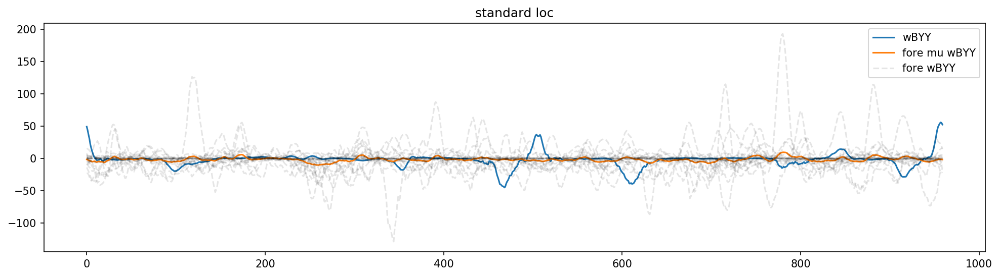

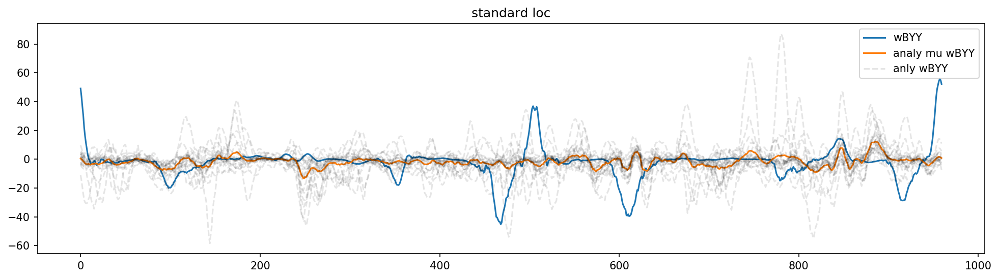

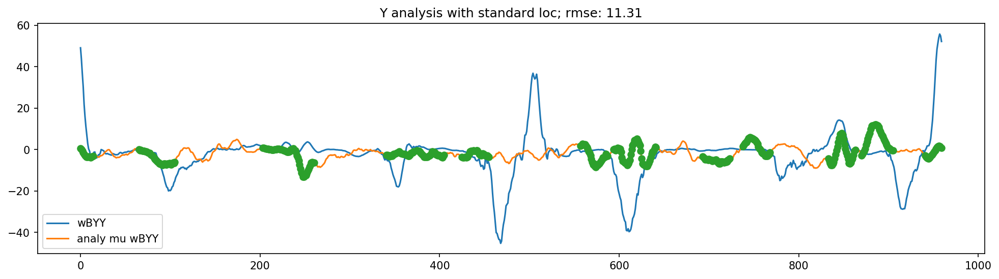

In [1612]:
BYY_GT = b**2 * utilities.bracket([Y_GT[:, 0]], 1)
wBYY_GT = utilities.window_sum_Z(BYY_GT, I=I, alpha=alpha, beta=beta)

BYY_ens_f = b**2 * utilities.bracket([this_Y_ens_f], 1)
wBYY_ens_f = utilities.window_sum_Z(BYY_ens_f, I=I, alpha=alpha, beta=beta)

BYY_ens_a = b**2 * utilities.bracket([this_Y_ens_a], 1)
wBYY_ens_a = utilities.window_sum_Z(BYY_ens_a, I=I, alpha=alpha, beta=beta)

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_f, axis=-1))
plt.plot(wBYY_ens_f, 'k--', alpha=.1)
plt.legend(['wBYY', 'fore mu wBYY', 'fore wBYY'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_a, axis=-1))
plt.plot(wBYY_ens_a, 'k--', alpha=.1)
plt.legend(['wBYY', 'analy mu wBYY', 'anly wBYY'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_a, axis=-1))
plt.plot(Zd_obs_loc, np.mean(wBYY_ens_a, axis=-1)[Zd_obs_loc], 'o')
plt.legend(['wBYY', 'analy mu wBYY'])

mu = np.mean(wBYY_ens_a, axis=-1)
rmse = np.sqrt(((mu - wBYY_GT)**2).mean())
plt.title(f'Y analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'standard loc')

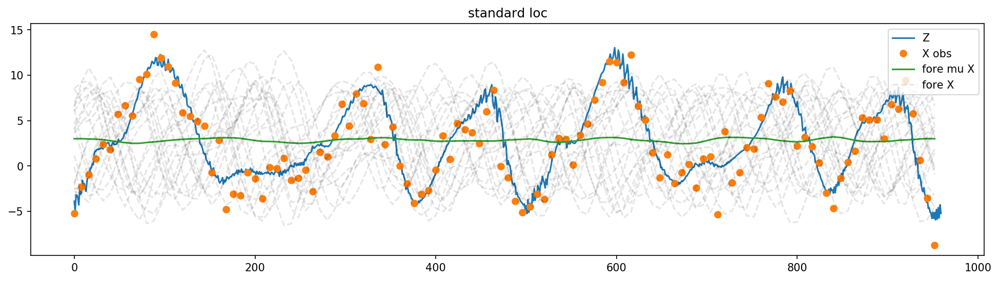

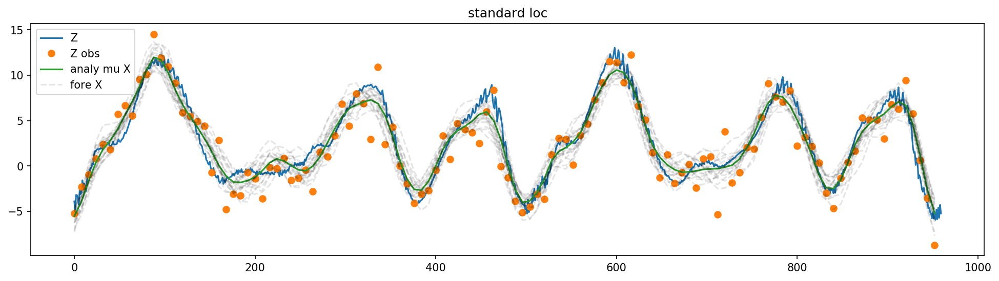

In [1613]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X0_ens, axis=-1))
plt.plot(x_coar, X0_ens[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'X obs', 'fore mu X', 'fore X'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X_ens_a, axis=-1))
plt.plot(x_coar, X_ens_a[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'analy mu X', 'fore X'])
plt.title(atitle)

# No localization

In [1614]:
atitle = 'no loc'

In [1615]:
use_SVD_loc = False
X_ens_a, Z_ens_a = assimilate.dual_scale_enkf(
    X_ens=X0_ens, X_obs=X_obs, H_X=H_Xc, R_X=R_Xc,
    Z_ens=Z0_ens, Z_obs=Z_obs, H_Z=H_Z, R_Z=R_Z,
    H_sub=H_sub, R_sub=R_sub, coarse=coarse, use_SVD_loc=use_SVD_loc)

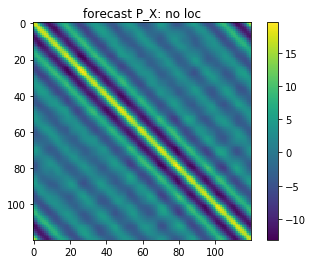

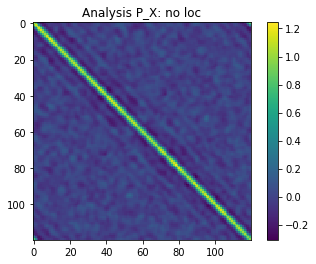

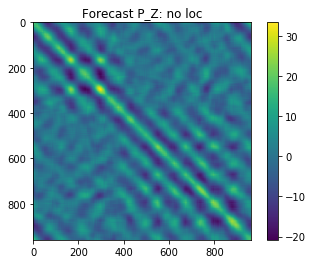

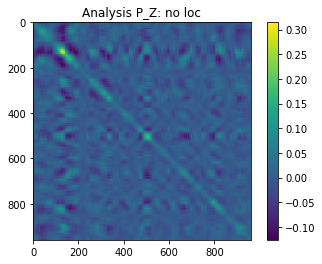

In [1616]:
P_X_f = np.cov(X0_ens)
P_X_a = np.cov(X_ens_a)
P_Z_f = np.cov(Z0_ens)
P_Z_a = np.cov(Z_ens_a)

imshow(P_X_f, f'forecast P_X: {atitle}')
imshow(P_X_a, f'Analysis P_X: {atitle}')
imshow(P_Z_f, f'Forecast P_Z: {atitle}')
imshow(P_Z_a, f'Analysis P_Z: {atitle}')

Text(0.5,1,'Z analysis with no loc; rmse: 3.888')

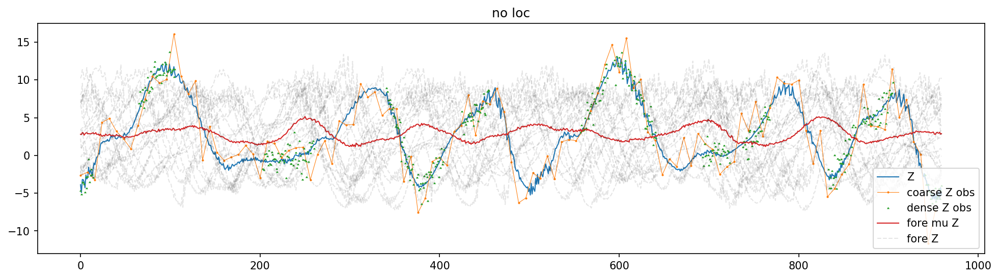

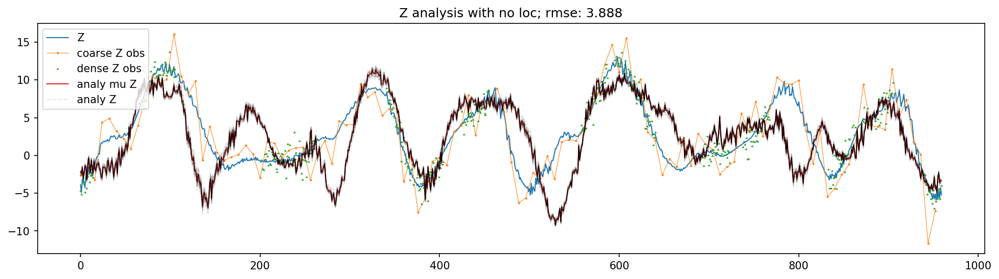

In [1617]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z0_ens, axis=-1), linewidth=1)
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore mu Z', 'fore Z'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z_ens_a, axis=-1), linewidth=1)
plt.plot(Z_ens_a, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy mu Z', 'analy Z'])

mu = np.mean(Z_ens_a, axis=-1)
rmse = np.sqrt(((mu - Z_GT[:, 0])**2).mean())
plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'Z analysis with no loc; rmse: 3.888')

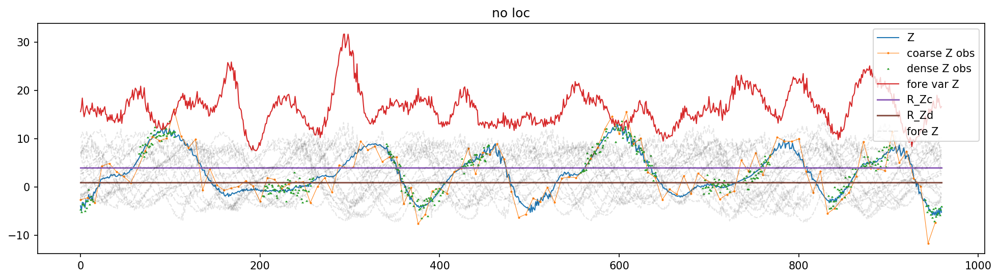

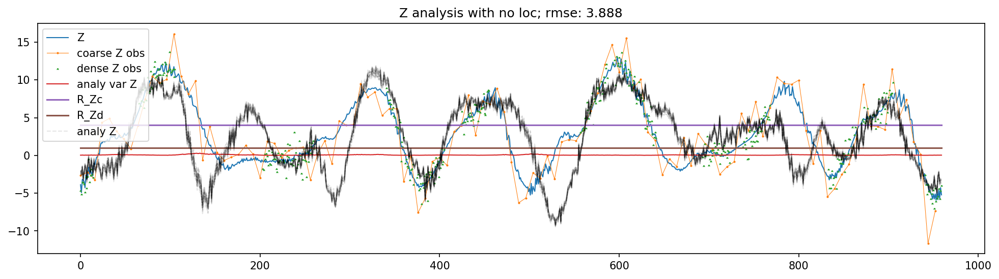

In [1618]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.var(Z0_ens, axis=-1), linewidth=1)
plt.plot(R_Zc_sd**2 * np.ones_like(Z_GT[:, 0]))
plt.plot(R_Zd_sd**2 * np.ones_like(Z_GT[:, 0]))
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore var Z', 'R_Zc', 'R_Zd', 'fore Z'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.var(Z_ens_a, axis=-1), linewidth=1)
plt.plot(R_Zc_sd**2 * np.ones_like(Z_GT[:, 0]))
plt.plot(R_Zd_sd**2 * np.ones_like(Z_GT[:, 0]))
plt.plot(Z_ens_a, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy var Z', 'R_Zc', 'R_Zd', 'analy Z'])

mu = np.mean(Z_ens_a, axis=-1)
rmse = np.sqrt(((mu - Z_GT[:, 0])**2).mean())
plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'Y analysis with no loc; rmse: 0.6739')

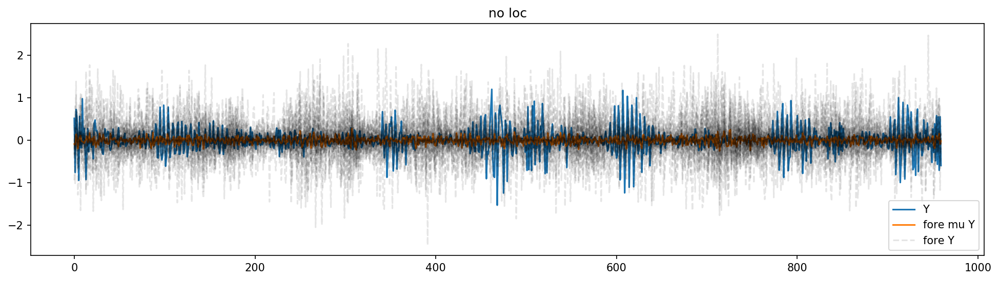

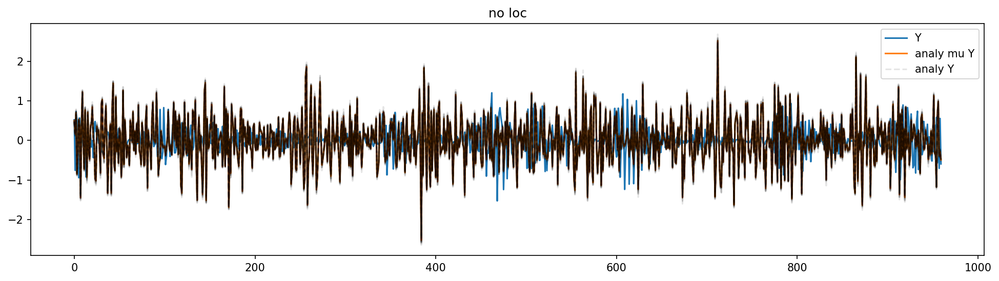

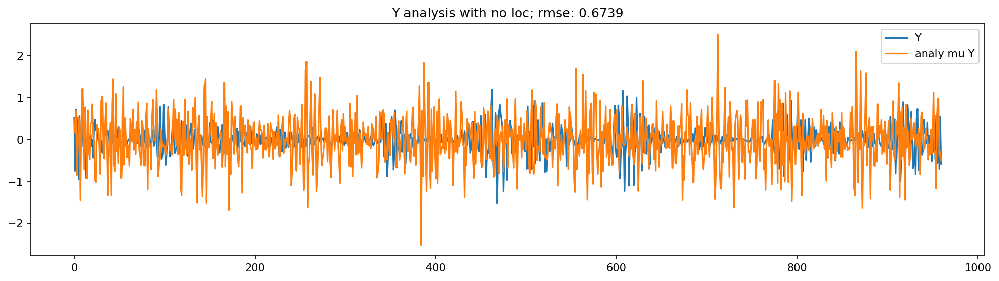

In [1619]:
this_X_ens_f = utilities.window_sum_Z(Z0_ens, I=I, alpha=alpha, beta=beta)
this_Y_ens_f = Z0_ens - this_X_ens_f

this_X_ens_a = utilities.window_sum_Z(Z_ens_a, I=I, alpha=alpha, beta=beta)
this_Y_ens_a = Z_ens_a - this_X_ens_a


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_f, axis=-1))
plt.plot(this_Y_ens_f, 'k--', alpha=.1)
plt.legend(['Y', 'fore mu Y', 'fore Y'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_a, axis=-1))
plt.plot(this_Y_ens_a, 'k--', alpha=.1)
plt.legend(['Y', 'analy mu Y', 'analy Y'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_a, axis=-1))
plt.legend(['Y', 'analy mu Y'])

mu = np.mean(this_Y_ens_a, axis=-1)
rmse = np.sqrt(((mu - Y_GT[:, 0])**2).mean())
plt.title(f'Y analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'Y analysis with no loc; rmse: 29.64')

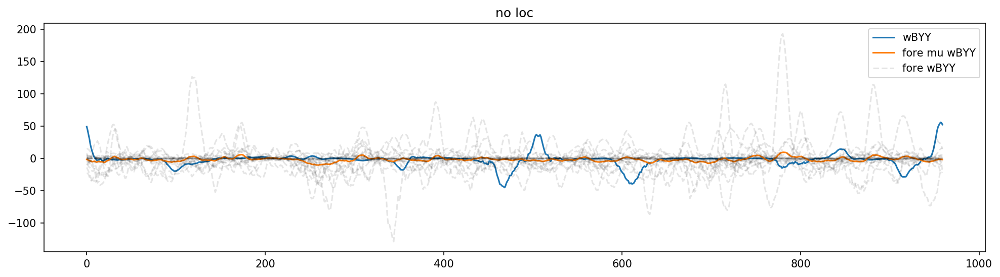

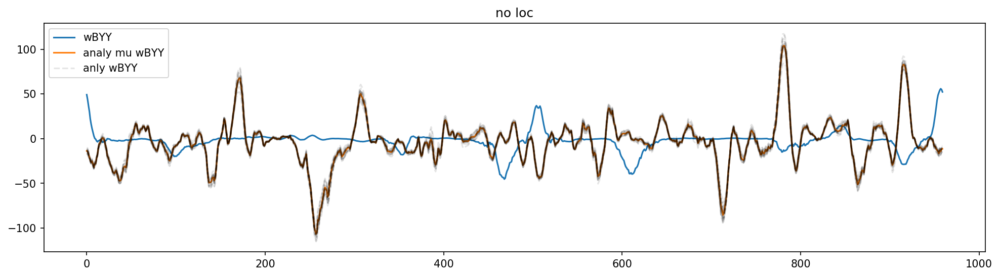

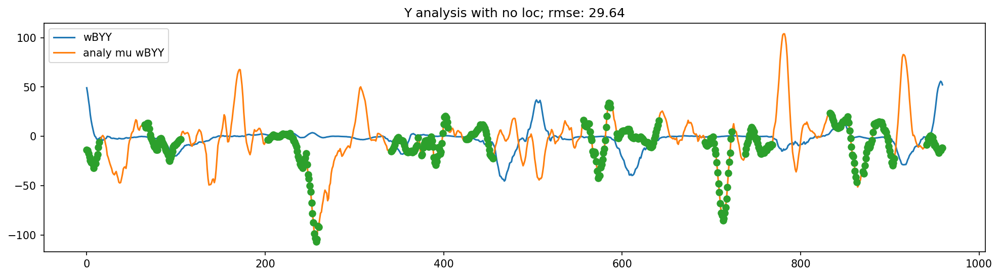

In [1620]:
BYY_GT = b**2 * utilities.bracket([Y_GT[:, 0]], 1)
wBYY_GT = utilities.window_sum_Z(BYY_GT, I=I, alpha=alpha, beta=beta)

BYY_ens_f = b**2 * utilities.bracket([this_Y_ens_f], 1)
wBYY_ens_f = utilities.window_sum_Z(BYY_ens_f, I=I, alpha=alpha, beta=beta)

BYY_ens_a = b**2 * utilities.bracket([this_Y_ens_a], 1)
wBYY_ens_a = utilities.window_sum_Z(BYY_ens_a, I=I, alpha=alpha, beta=beta)

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_f, axis=-1))
plt.plot(wBYY_ens_f, 'k--', alpha=.1)
plt.legend(['wBYY', 'fore mu wBYY', 'fore wBYY'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_a, axis=-1))
plt.plot(wBYY_ens_a, 'k--', alpha=.1)
plt.legend(['wBYY', 'analy mu wBYY', 'anly wBYY'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_a, axis=-1))
plt.plot(Zd_obs_loc, np.mean(wBYY_ens_a, axis=-1)[Zd_obs_loc], 'o')
plt.legend(['wBYY', 'analy mu wBYY'])

mu = np.mean(wBYY_ens_a, axis=-1)
rmse = np.sqrt(((mu - wBYY_GT)**2).mean())
plt.title(f'Y analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'no loc')

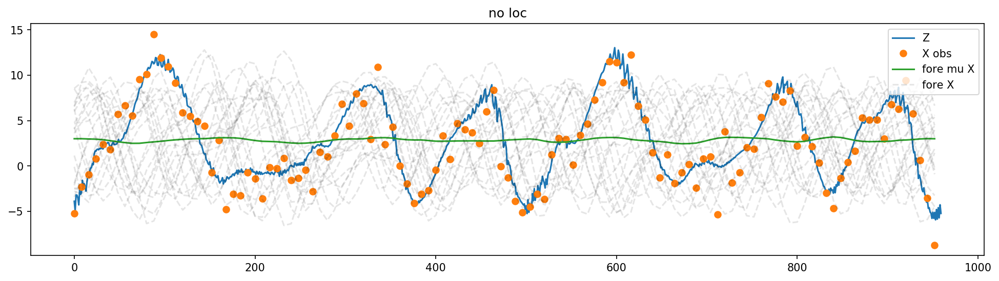

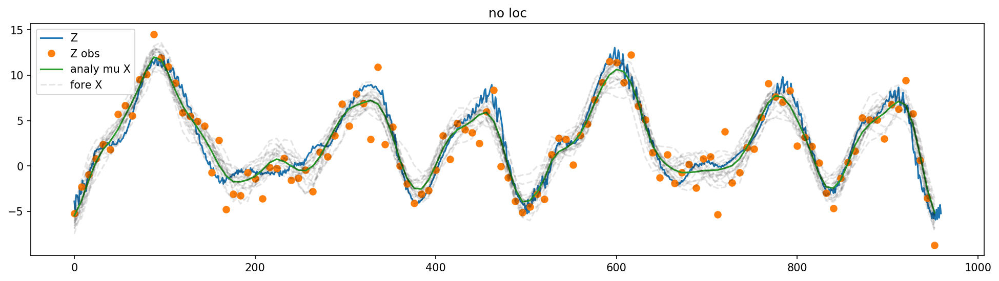

In [1621]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X0_ens, axis=-1))
plt.plot(x_coar, X0_ens[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'X obs', 'fore mu X', 'fore X'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X_ens_a, axis=-1))
plt.plot(x_coar, X_ens_a[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'analy mu X', 'fore X'])
plt.title(atitle)

# Use P_X localization

In [1622]:
# use_SVD_loc = False
# use_P_X = True
# X_ens_a, Z_ens_a = assimilate.dual_scale_enkf(
#     X0_ens, Z0_ens, X_obs, Z_obs, H=H, R=R, R_coar=R_coar,
#     H_sub=H_sub, R_sub=R_sub, coarse=coarse,
#     use_SVD_loc=use_SVD_loc,
#     use_P_X=use_P_X)

In [1623]:
atitle = 'P_X loc'

In [1624]:
use_SVD_loc = False
use_P_X = True

X_ens_a, Z_ens_a = assimilate.dual_scale_enkf(
    X_ens=X0_ens, X_obs=X_obs, H_X=H_Xc, R_X=R_Xc,
    Z_ens=Z0_ens, Z_obs=Z_obs, H_Z=H_Z, R_Z=R_Z,
    H_sub=H_sub, R_sub=R_sub, coarse=coarse,
    use_SVD_loc=use_SVD_loc, use_P_X=use_P_X)

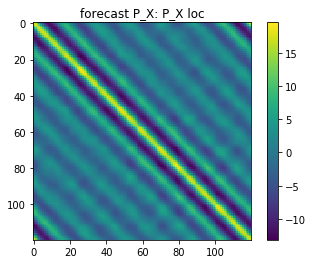

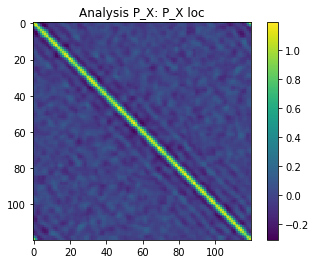

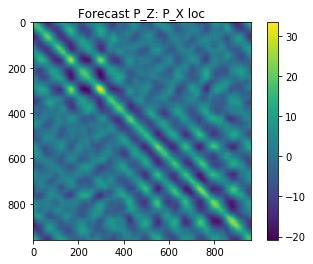

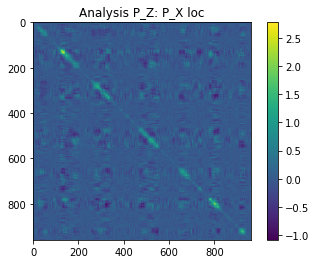

In [1625]:
P_X_f = np.cov(X0_ens)
P_X_a = np.cov(X_ens_a)
P_Z_f = np.cov(Z0_ens)
P_Z_a = np.cov(Z_ens_a)

imshow(P_X_f, f'forecast P_X: {atitle}')
imshow(P_X_a, f'Analysis P_X: {atitle}')
imshow(P_Z_f, f'Forecast P_Z: {atitle}')
imshow(P_Z_a, f'Analysis P_Z: {atitle}')

Text(0.5,1,'Z analysis with P_X loc; rmse: 0.6661')

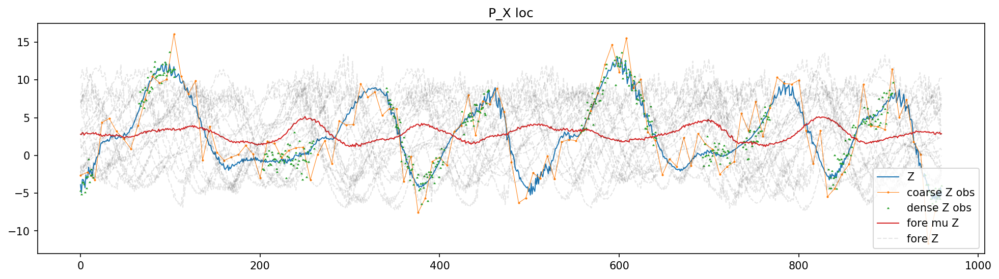

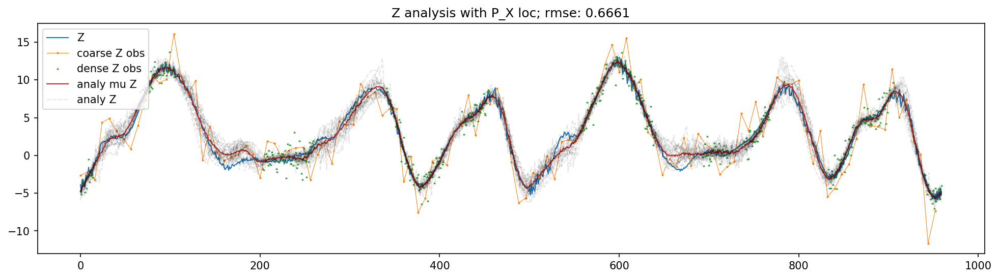

In [1626]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z0_ens, axis=-1), linewidth=1)
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore mu Z', 'fore Z'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z_ens_a, axis=-1), linewidth=1)
plt.plot(Z_ens_a, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy mu Z', 'analy Z'])

mu = np.mean(Z_ens_a, axis=-1)
rmse = np.sqrt(((mu - Z_GT[:, 0])**2).mean())
plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'Z analysis with P_X loc; rmse: 0.6661')

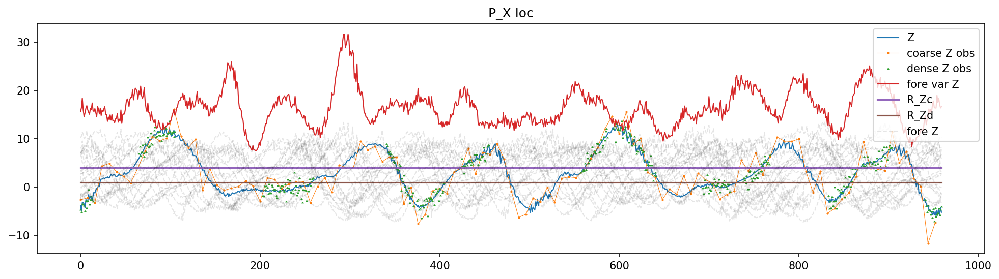

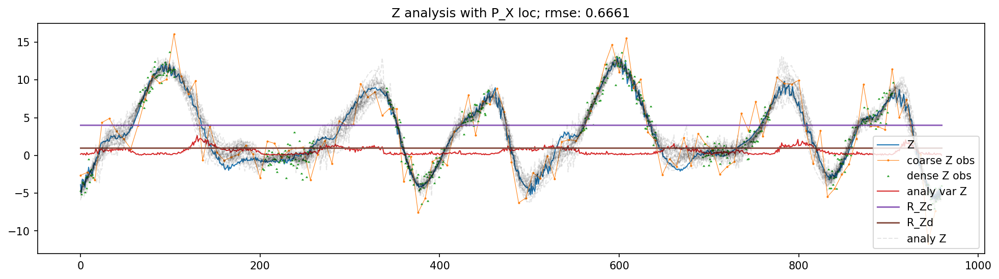

In [1627]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.var(Z0_ens, axis=-1), linewidth=1)
plt.plot(R_Zc_sd**2 * np.ones_like(Z_GT[:, 0]))
plt.plot(R_Zd_sd**2 * np.ones_like(Z_GT[:, 0]))
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore var Z', 'R_Zc', 'R_Zd', 'fore Z'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=1)
plt.plot(Zc_obs_loc, Z_obs[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs[N_co:], '^', markersize=.75)
plt.plot(np.var(Z_ens_a, axis=-1), linewidth=1)
plt.plot(R_Zc_sd**2 * np.ones_like(Z_GT[:, 0]))
plt.plot(R_Zd_sd**2 * np.ones_like(Z_GT[:, 0]))
plt.plot(Z_ens_a, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy var Z', 'R_Zc', 'R_Zd', 'analy Z'])

mu = np.mean(Z_ens_a, axis=-1)
rmse = np.sqrt(((mu - Z_GT[:, 0])**2).mean())
plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'Y analysis with P_X loc; rmse: 0.309')

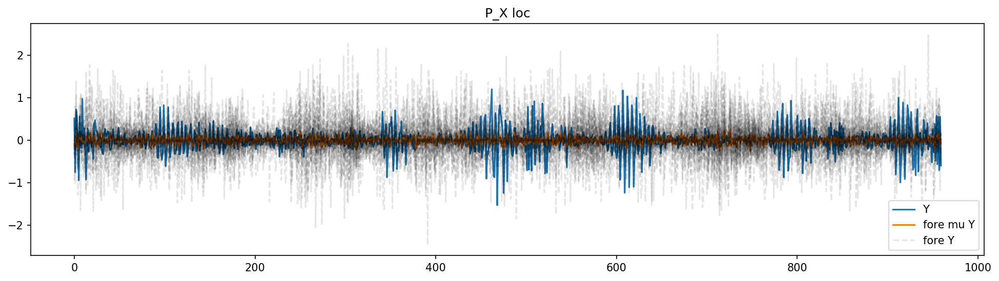

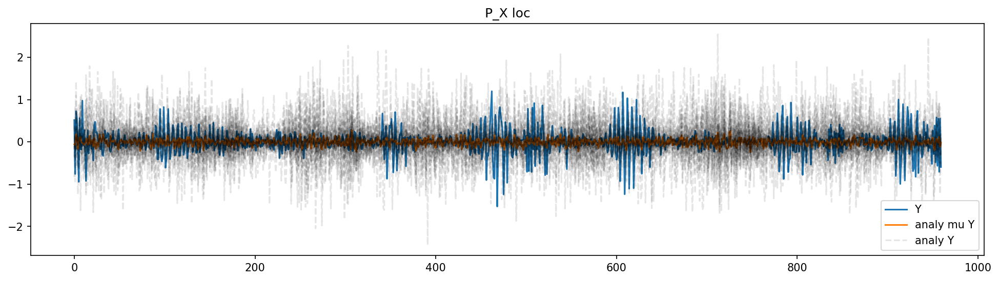

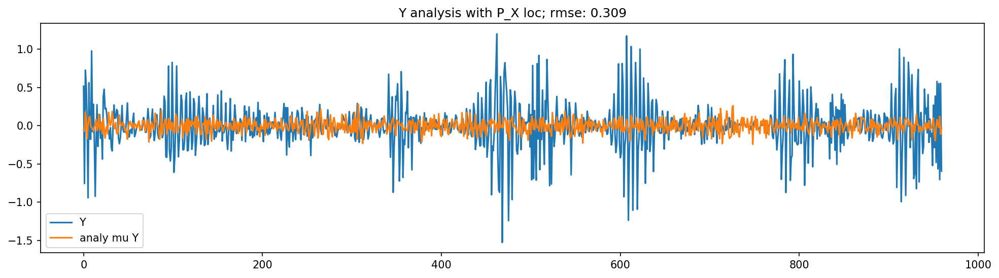

In [1628]:
this_X_ens_f = utilities.window_sum_Z(Z0_ens, I=I, alpha=alpha, beta=beta)
this_Y_ens_f = Z0_ens - this_X_ens_f

this_X_ens_a = utilities.window_sum_Z(Z_ens_a, I=I, alpha=alpha, beta=beta)
this_Y_ens_a = Z_ens_a - this_X_ens_a


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_f, axis=-1))
plt.plot(this_Y_ens_f, 'k--', alpha=.1)
plt.legend(['Y', 'fore mu Y', 'fore Y'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_a, axis=-1))
plt.plot(this_Y_ens_a, 'k--', alpha=.1)
plt.legend(['Y', 'analy mu Y', 'analy Y'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_GT[:, 0])
plt.plot(np.mean(this_Y_ens_a, axis=-1))
plt.legend(['Y', 'analy mu Y'])

mu = np.mean(this_Y_ens_a, axis=-1)
rmse = np.sqrt(((mu - Y_GT[:, 0])**2).mean())
plt.title(f'Y analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'Y analysis with P_X loc; rmse: 11.92')

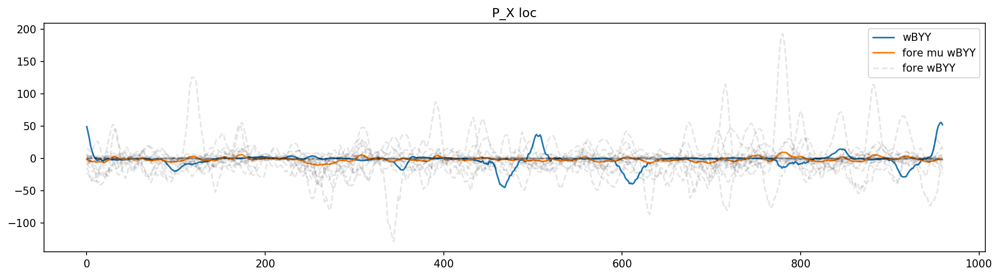

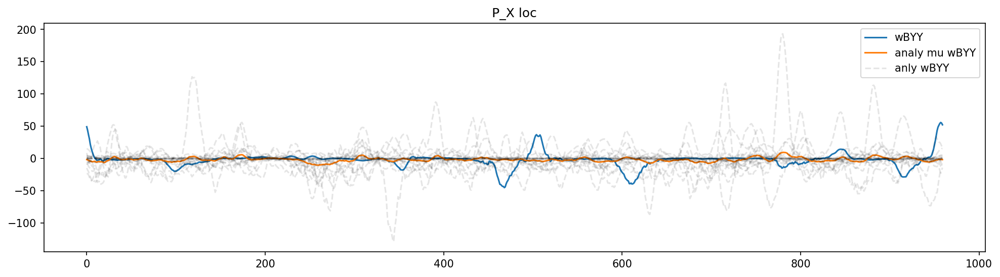

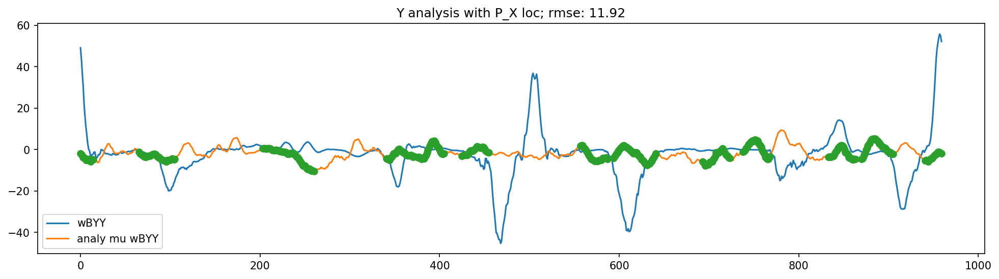

In [1629]:
BYY_GT = b**2 * utilities.bracket([Y_GT[:, 0]], 1)
wBYY_GT = utilities.window_sum_Z(BYY_GT, I=I, alpha=alpha, beta=beta)

BYY_ens_f = b**2 * utilities.bracket([this_Y_ens_f], 1)
wBYY_ens_f = utilities.window_sum_Z(BYY_ens_f, I=I, alpha=alpha, beta=beta)

BYY_ens_a = b**2 * utilities.bracket([this_Y_ens_a], 1)
wBYY_ens_a = utilities.window_sum_Z(BYY_ens_a, I=I, alpha=alpha, beta=beta)

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_f, axis=-1))
plt.plot(wBYY_ens_f, 'k--', alpha=.1)
plt.legend(['wBYY', 'fore mu wBYY', 'fore wBYY'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_a, axis=-1))
plt.plot(wBYY_ens_a, 'k--', alpha=.1)
plt.legend(['wBYY', 'analy mu wBYY', 'anly wBYY'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(wBYY_GT)
plt.plot(np.mean(wBYY_ens_a, axis=-1))
plt.plot(Zd_obs_loc, np.mean(wBYY_ens_a, axis=-1)[Zd_obs_loc], 'o')
plt.legend(['wBYY', 'analy mu wBYY'])

mu = np.mean(wBYY_ens_a, axis=-1)
rmse = np.sqrt(((mu - wBYY_GT)**2).mean())
plt.title(f'Y analysis with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'P_X loc')

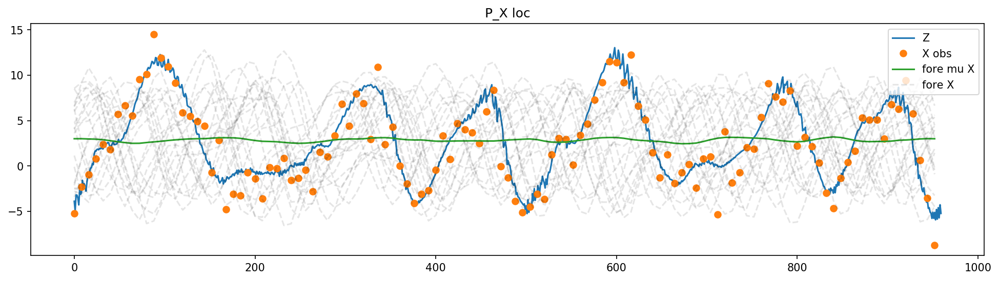

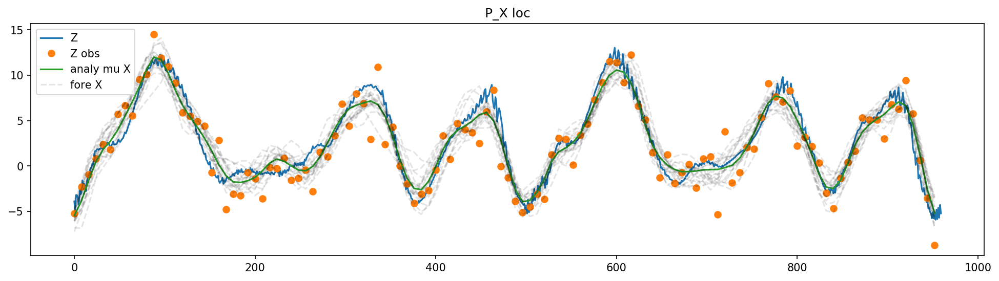

In [1630]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X0_ens, axis=-1))
plt.plot(x_coar, X0_ens[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'X obs', 'fore mu X', 'fore X'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X_ens_a, axis=-1))
plt.plot(x_coar, X_ens_a[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'analy mu X', 'fore X'])
plt.title(atitle)